<a href="https://colab.research.google.com/github/harrietf/DAR_adversarial/blob/main/DAR_PGD_imagenet.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Distributed Adversarial Region (DAR) Attack

# Set up



In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
import scipy as sp
import numpy as np
import pandas as pd
import matplotlib as mpl
import matplotlib.pyplot as plt
import tensorflow as tf
from keras.models import Sequential
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from PIL import Image
import cv2
import os
from tqdm import tqdm
from mpl_toolkits.axes_grid1 import ImageGrid

Setting up image axes

In [ ]:
mpl.rcParams['figure.figsize'] = (8, 8)
mpl.rcParams['axes.grid'] = False

## Loading models

MobileNetV2

In [ ]:
mobilenetv2 = tf.keras.applications.MobileNetV2(include_top=True,
                                                     weights='imagenet')
mobilenetv2.trainable = False

# ImageNet labels
mobilenetv2_predictions = tf.keras.applications.mobilenet_v2.decode_predictions

14536120/14536120 [==============================] - 1s 0us/step


NasNet

In [ ]:
nasnet = tf.keras.applications.NASNetMobile(include_top=True,
                                                     weights='imagenet')
nasnet.trainable = False

# ImageNet labels
nasnet_predictions = tf.keras.applications.nasnet.decode_predictions

24227760/24227760 [==============================] - 1s 0us/step


Densenet169

In [ ]:
densenet = tf.keras.applications.DenseNet169(include_top=True,
                                                     weights='imagenet')
densenet.trainable = False

# ImageNet labels
densenet_predictions = tf.keras.applications.densenet.decode_predictions

58541896/58541896 [==============================] - 2s 0us/step


# Set up functions (image preprocessing etc)

In [ ]:
def preprocess(image):
  image = tf.cast(image, tf.float32)
  image = tf.image.resize(image, (224, 224))
  image = tf.keras.applications.mobilenet_v2.preprocess_input(image)
  image = image[None, ...]
  return image

# Function to extract labels from probability vector
def get_imagenet_label(probs):
  return mobilenetv2_predictions(probs, top=1)[0][0]

image_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Object_1/obj6__10.png")
image = tf.image.decode_image(image_raw)
image = preprocess(image)
image_probs = mobilenetv2.predict(image)

import scipy.misc

def display_save_images(image, filename, obj):
  plt.figure()
  plt.imshow(image[0] * 0.5 + 0.5)  # To change [-1, 1] to [0,1]
  _, image_class, class_confidence = get_imagenet_label(image_probs)
  #scipy.misc.toimage(image).save("/content/gdrive/MyDrive/Data/DAR_data/Pet_object_1/"+str(filename)+".png")
  #ax=fig.add_subplot(1,1,1)
  #extent = ax.get_window_extent().transformed(fig.dpi_scale_trans.inverted())
  plt.axis('off')
  plt.savefig("/content/gdrive/MyDrive/Data/DAR_data/"+str(filename)+".png", bbox_inches='tight', transparent=True, pad_inches=0)
  plt.show()
  
def display_images(image):
  plt.figure()
  plt.imshow(image[0] * 0.5 + 0.5)  # To change [-1, 1] to [0,1]
  _, image_class, class_confidence = get_imagenet_label(image_probs)
  plt.show()

1/1 [==============================] - 8s 8s/step


# DAR params

In [ ]:
#size = [6,8,10,12,14]
#number = [2,3,4,5]

# DAR function to create random DARs (non region optimised)

In [ ]:
#Create new blank image to build DARs on
#defining the function to clip values
def clip_eps(tensor, eps):
	# clip the values of the tensor to a given range and return it
	return tf.clip_by_value(tensor, clip_value_min=-eps,
		clip_value_max=eps)
 
def create_dars():
  dars = np.zeros(150528)
  dars = dars.reshape(1,224,224,3)
  return dars

car = "Object_1"
cup = "Object_2"
frog = "Object_3"
plate = "Object_4"
tank = "Object_5"
boat = "Object_6"
sandwich = "Object_7"
duck = "Object_8"

def create_adv_dars(obj):
  #Indices of labels
  real_label_index = 751 #Aircraft carrier
  image_probs = mobilenetv2.predict(image)

  #Real label - air carrier
  real_label = tf.one_hot(real_label_index, image_probs.shape[-1])
  real_label = tf.reshape(real_label, (1, image_probs.shape[-1]))

  loss_object = tf.keras.losses.CategoricalCrossentropy()
  input_image = image

  LR = 5e-3
  EPS = 2 / 255.0 #Clipping the delta values so it's not too obvious
  iterations = 5
  epsilons = 4

  #Defining image and optimiser
  delta = tf.Variable(tf.zeros_like(image), trainable=True)
  baseImage = tf.constant(image, dtype=tf.float32)
  #delta2 = tf.constant(image, dtype=tf.float32)
  optimizer = tf.keras.optimizers.Adam(learning_rate=LR)

  dars = create_dars()

  #DAR1
  #performing the (untargeted) optimisation, generating perturbation vector
  for iteration in range(0, iterations):  
    with tf.GradientTape() as tape:
      tape.watch(delta[0,75:90,75:90])   
      adversary = baseImage + delta
      prediction = mobilenetv2(adversary)
 
      real_loss = loss_object(real_label, prediction)
      #target_loss = loss_object(target_label, prediction)
      total_loss = -real_loss

    gradient = tape.gradient(total_loss, delta)
    signed_grad = tf.sign(gradient)

    optimizer.apply_gradients([(gradient, delta)])
    delta.assign_add(clip_eps(delta, eps=EPS))

  dars[0,75:90,75:90] = delta[0,75:90,75:90]

  new_img = image + (dars*10)

  #Predicting with different models
  image_probs_mobilenetv2 = mobilenetv2.predict(new_img)
  _, image_class_m, class_confidence_m = get_imagenet_label(image_probs_mobilenetv2)
  print(mobilenetv2_predictions(mobilenetv2.predict(new_img)))

  image_probs_nasnet = nasnet.predict(new_img)
  _, image_class_n, class_confidence_n = get_imagenet_label(image_probs_nasnet)

  #Saving to array
  imgclassmobilenet.append(image_class_m)
  predsmobilenet.append(class_confidence_m)
  imgclassnasnet.append(image_class_n)
  predsnasnet.append(class_confidence_n)

  display_save_images(new_img, file, obj) 
  return new_img

# Set up to DAR attack

Calculate gradient signs across the entire image

In [ ]:
def create_dar(input_image, input_label):
  with tf.GradientTape() as tape:
    tape.watch(input_image)
    prediction = mobilenetv2(input_image)
    loss = loss_object(input_label, prediction)

  # Get the gradients of the loss w.r.t to the input image.
  gradient = tape.gradient(loss, input_image)
  # Get the sign of the gradients to create the perturbation
  signed_grad = tf.sign(gradient)
  return signed_grad

#gradient_mags = create_dar(image, label)

np.random.seed(1)

def gen_mod_results():
  results = pd.DataFrame(
    {'size_val': size_val,
     'num_val': num_val,
     'imgclassmobilenet': imgclassmobilenet,
     'predsmobilenet': predsmobilenet,  
     'imgclassmobilenet_top2': imgclassmobilenet_top2,
     'predsmobilenet_top2': predsmobilenet_top2,
     'imgclassmobilenet_top3': imgclassmobilenet_top3,
     'predsmobilenet_top3': predsmobilenet_top3,
     'imgclassnasnet': imgclassnasnet,
     'predsnasnet': predsnasnet,
     'imgclassnasnet_top2': imgclassnasnet_top2,
     'predsnasnet_top2': predsnasnet_top2,  
     'imgclassnasnet_top3': imgclassnasnet_top3,
     'predsnasnet_top3': predsnasnet_top3,  
     'imgclassdensenet': imgclassdensenet,
     'predsdensenet': predsdensenet,
     'imgclassdensenet_top2': imgclassdensenet_top2,
     'predsdensenet_top2': predsdensenet_top2,
     'imgclassdensenet_top3': imgclassdensenet_top3,
     'predsdensenet_top3': predsdensenet_top3
    })
  return results

def gen_mod_results_pet():
  results = pd.DataFrame(
    {'size_val': size_val,
     'num_val': num_val,
     'imgclassmobilenetpet': imgclassmobilenetpet,
     'predsmobilenetpet': predsmobilenetpet,
     'imgclassmobilenetpet_top2': imgclassmobilenetpet_top2,
     'predsmobilenetpet_top2': predsmobilenetpet_top2,
     'imgclassmobilenetpet_top3': imgclassmobilenetpet_top3,
     'predsmobilenetpet_top3': predsmobilenetpet_top3,
     'imgclassnasnetpet': imgclassnasnetpet,
     'predsnasnetpet': predsnasnetpet,
     'imgclassnasnetpet_top2': imgclassnasnetpet_top2,
     'predsnasnetpet_top2': predsnasnetpet_top2,
     'imgclassnasnetpet_top3': imgclassnasnetpet_top3,
     'predsnasnetpet_top3': predsnasnetpet_top3,
     'imgclassdensenetpet': imgclassdensenetpet,
     'predsdensenetpet': predsdensenetpet,
     'imgclassdensenetpet_top2': imgclassdensenetpet_top2,
     'predsdensenetpet_top2': predsdensenetpet_top2,
     'imgclassdensenetpet_top3': imgclassdensenetpet_top3,
     'predsdensenetpet_top3': predsdensenetpet_top3
    })
  return results

# DAR function that automatically optimises for location


Defining required parameters for the section

In [ ]:
def gen_results(): #Note there is another gen results function above that saves results from different models
  results = pd.DataFrame(
    {'x_value': x_value,
     'y_value': y_value,
     'confidence': conf_results,
     'include' : include
    })
  #results.loc[(results['x_value'] >x_excl) & (results['x_value'] <(x_excl+x_len)), 'include'] = 0 #Set values in ship area to 0 (not include)
  #results.loc[(results['y_value'] >y_excl) & (results['y_value'] <(y_excl+y_len)), 'include'] = 0
  #results.to_csv("/content/gdrive/MyDrive/PhD/Chapter 1 - AML attack/results.csv", sep='\t')
  return results

In [ ]:
def adv_dar(input_image):
    epsilons = 4
    x_start = 0
    y_start = 0
    pixel_max = 224
    interval= 30 #Distance for which the squares are shifted and sampled
    iterations = 1000 #Max number of loops to try over image (change below for DAR creation)
    delta = tf.Variable(tf.zeros_like(image), trainable=True)
    accuracy = tf.Variable(tf.zeros_like([]), tf.int32)
    baseImage = tf.constant(image, dtype=tf.float32)
    LR = 5e-3
    EPS = 2 / 255.0 #Clipping the delta values so it's not too obvious
    optimizer = tf.keras.optimizers.Adam(learning_rate=LR)
    loss_object = tf.keras.losses.CategoricalCrossentropy()
    real_label = tf.one_hot(real_label_index, image_probs.shape[-1])
    real_label = tf.reshape(real_label, (1, image_probs.shape[-1]))

    for iteration in range(0, iterations):  
      #for i in range(x_start, iterations):
      dars = create_dars()
      with tf.GradientTape() as tape:
        tape.watch(delta[0,y_start:y_start+interval,x_start:x_start+interval])   
        adversary = baseImage + delta
        prediction = mobilenetv2(adversary)
        real_loss = loss_object(real_label, prediction)
        #target_loss = loss_object(target_label, prediction)
        total_loss = -real_loss
      gradient = tape.gradient(total_loss, delta)
      signed_grad = tf.sign(gradient)
      optimizer.apply_gradients([(gradient, delta)])
      delta.assign_add(clip_eps(delta, eps=EPS))
      dars[0,y_start:y_start+interval,x_start:x_start+interval] = delta[0,y_start:y_start+interval,x_start:x_start+interval]
      new_img = image + (dars*10)
      _, image_class, class_confidence = mobilenetv2_predictions(mobilenetv2.predict(new_img), top=1)[0][0]
      #display_images(new_img)
      #print(x_start)
      #print(y_start)
      #print(class_confidence) 
      x_value.append(x_start)
      y_value.append(y_start)
      conf_results.append(class_confidence)      
      if x_start <= 230:
          x_start= x_start+interval
      elif y_start <=230:
          x_start = 0
          y_start = y_start + interval
      elif y_start > 230: 
          break

    return x_start,class_confidence
    return x_value, y_value, conf_results
    
def create_adv_dars_auto(s, n):
  real_label = tf.one_hot(real_label_index, image_probs.shape[-1])
  real_label = tf.reshape(real_label, (1, image_probs.shape[-1]))

  loss_object = tf.keras.losses.CategoricalCrossentropy()

  size = s
  number = n

  q=lambda a: (abs(a)+a)/2 #Function to set number as positive or zero when blurring dars

  #Variables
  input_image = image
  LR = 5e-3
  EPS = 2 / 255.0 #Clipping the delta values so it's not too obvious

  #Defining image and optimiser
  delta = tf.Variable(tf.zeros_like(image), trainable=True)
  accuracy = tf.Variable(tf.zeros_like([]), tf.int32)
  baseImage = tf.constant(image, dtype=tf.float32)
  #delta2 = tf.constant(image, dtype=tf.float32)
  optimizer = tf.keras.optimizers.Adam(learning_rate=LR)

  #Defining function that calculated confidence based on iterating through regions

  results = gen_results()

  #results.to_csv("/content/gdrive/MyDrive/PhD/Chapter 1 - AML attack/"+Obj+"results.csv", sep='\t')

  x1 = results.loc[results['confidence'].idxmin()]['x_value']
  y1 = results.loc[results['confidence'].idxmin()]['y_value']
  results.loc[results.x_value == x1, 'include'] = "0"
  results.loc[results.y_value == y1, 'include'] = "0"

  c2 = results[results['include']==1]
  x2 = c2.loc[c2['confidence'].idxmin()]['x_value']
  y2 = c2.loc[c2['confidence'].idxmin()]['y_value']
  c2.loc[c2.x_value == x2, 'include'] = "0"
  c2.loc[c2.y_value == y2, 'include'] = "0"

  c3 = c2[c2['include']==1]
  x3 = c3.loc[c3['confidence'].idxmin()]['x_value']
  y3 = c3.loc[c3['confidence'].idxmin()]['y_value']
  c3.loc[c3.x_value == x3, 'include'] = "0"
  c3.loc[c3.y_value == y3, 'include'] = "0"

  c4 = c3[c3['include']==1]
  x4 = c4.loc[c4['confidence'].idxmin()]['x_value']
  y4 = c4.loc[c4['confidence'].idxmin()]['y_value']

  x1 = int(x1)
  x2 = int(x2)
  x3 = int(x3)
  x4 = int(x4)
  y1 = int(y1)
  y2 = int(y2)
  y3 = int(y3)
  y4 = int(y4)

  if number ==1:
    #Set up
    x_cen_1 = x1
    y_cen_1 = y1
    print(x_cen_1)
    print(y_cen_1)
    dars = create_dars()
    iterations = 20 #Iterations to optimise DARs (different to iterations above). Note increasing this makes it very slow so do that last.

    for iteration in range(0, iterations):  
      with tf.GradientTape() as tape:
        tape.watch(delta[0,y_cen_1-int(size/2):y_cen_1+int(size/2),x_cen_1-int(size/2):x_cen_1+int(size/2)])   
        adversary = baseImage + delta
        prediction = model(adversary)

        real_loss = loss_object(real_label, prediction)
        #target_loss = loss_object(target_label, prediction)
        total_loss = -real_loss

      gradient = tape.gradient(total_loss, delta)
      signed_grad = tf.sign(gradient)

      optimizer.apply_gradients([(gradient, delta)])
      delta.assign_add(clip_eps(delta, eps=EPS))

    dars[0,y_cen_1-int(size/2):y_cen_1+int(size/2),x_cen_1-int(size/2):x_cen_1+int(size/2)] = delta[0,y_cen_1-int(size/2):y_cen_1+int(size/2),x_cen_1-int(size/2):x_cen_1+int(size/2)]
    blur1 = cv2.blur(dars[0,int(q(y_cen_1-int(size/2))):y_cen_1+int(size/2),int(q(x_cen_1-int(size/2))):x_cen_1+int(size/2)],(3,3))
    dars[0,int(q(y_cen_1-int(size/2))):y_cen_1+int(size/2),int(q(x_cen_1-int(size/2))):x_cen_1+int(size/2)] = blur1
    #This method using averaging by convolving the image with a normalized box filter

  if number == 2:
    #Set up
    x_cen_1 = x1
    y_cen_1 = y1
    print(x_cen_1)
    print(y_cen_1)
    dars = create_dars()
    iterations = 20 #Iterations to optimise DARs (different to iterations above). Note increasing this makes it very slow so do that last.

    for iteration in range(0, iterations):  
      with tf.GradientTape() as tape:
        tape.watch(delta[0,y_cen_1-int(size/2):y_cen_1+int(size/2),x_cen_1-int(size/2):x_cen_1+int(size/2)])   
        adversary = baseImage + delta
        prediction = model(adversary)

        real_loss = loss_object(real_label, prediction)
        #target_loss = loss_object(target_label, prediction)
        total_loss = -real_loss

      gradient = tape.gradient(total_loss, delta)
      signed_grad = tf.sign(gradient)

      optimizer.apply_gradients([(gradient, delta)])
      delta.assign_add(clip_eps(delta, eps=EPS))

    dars[0,y_cen_1-int(size/2):y_cen_1+int(size/2),x_cen_1-int(size/2):x_cen_1+int(size/2)] = delta[0,y_cen_1-int(size/2):y_cen_1+int(size/2),x_cen_1-int(size/2):x_cen_1+int(size/2)]
    blur1 = cv2.blur(dars[0,int(q(y_cen_1-int(size/2))):y_cen_1+int(size/2),int(q(x_cen_1-int(size/2))):x_cen_1+int(size/2)],(3,3))
    dars[0,int(q(y_cen_1-int(size/2))):y_cen_1+int(size/2),int(q(x_cen_1-int(size/2))):x_cen_1+int(size/2)] = blur1
    #This method using averaging by convolving the image with a normalized box filter

    #DAR2 based on minimum calculated prior
    x_cen_2 = x2
    y_cen_2 = y2
    print(x_cen_2)
    print(y_cen_2)
    #performing the (untargeted) optimisation, generating perturbation vector
    for iteration in range(0, iterations):  
      with tf.GradientTape() as tape:
        tape.watch(delta[0,y_cen_2-int(size/2):y_cen_2+int(size/2),x_cen_2-int(size/2):x_cen_2+int(size/2)])   
        adversary = baseImage + delta
        prediction = model(adversary)
    
        real_loss = loss_object(real_label, prediction)
        #target_loss = loss_object(target_label, prediction)
        total_loss = -real_loss

      gradient = tape.gradient(total_loss, delta)
      signed_grad = tf.sign(gradient)

      optimizer.apply_gradients([(gradient, delta)])
      delta.assign_add(clip_eps(delta, eps=EPS))

    dars[0,y_cen_2-int(size/2):y_cen_2+int(size/2),x_cen_2-int(size/2):x_cen_2+int(size/2)] = delta[0,y_cen_2-int(size/2):y_cen_2+int(size/2),x_cen_2-int(size/2):x_cen_2+int(size/2)]
    blur2 = cv2.blur(dars[0,int(q(y_cen_2-int(size/2))):y_cen_2+int(size/2),int(q(x_cen_2-int(size/2))):x_cen_2+int(size/2)],(3,3))
    dars[0,int(q(y_cen_2-int(size/2))):y_cen_2+int(size/2),int(q(x_cen_2-int(size/2))):x_cen_2+int(size/2)] = blur2
    #This method using averaging by convolving the image with a normalized box filter\

  elif number == 3:
    #DAR1
    x_cen_1 = x1
    y_cen_1 = y1
    print(x_cen_1)
    print(y_cen_1)
    dars = create_dars()
    iterations = 20 #Iterations to optimise DARs (different to iterations above). Note increasing this makes it very slow so do that last.

    for iteration in range(0, iterations):  
      with tf.GradientTape() as tape:
        tape.watch(delta[0,y_cen_1-int(size/2):y_cen_1+int(size/2),x_cen_1-int(size/2):x_cen_1+int(size/2)])   
        adversary = baseImage + delta
        prediction = model(adversary)

        real_loss = loss_object(real_label, prediction)
        #target_loss = loss_object(target_label, prediction)
        total_loss = -real_loss

      gradient = tape.gradient(total_loss, delta)
      signed_grad = tf.sign(gradient)

      optimizer.apply_gradients([(gradient, delta)])
      delta.assign_add(clip_eps(delta, eps=EPS))

    dars[0,y_cen_1-int(size/2):y_cen_1+int(size/2),x_cen_1-int(size/2):x_cen_1+int(size/2)] = delta[0,y_cen_1-int(size/2):y_cen_1+int(size/2),x_cen_1-int(size/2):x_cen_1+int(size/2)]
    blur1 = cv2.blur(dars[0,int(q(y_cen_1-int(size/2))):y_cen_1+int(size/2),int(q(x_cen_1-int(size/2))):x_cen_1+int(size/2)],(3,3))
    dars[0,int(q(y_cen_1-int(size/2))):y_cen_1+int(size/2),int(q(x_cen_1-int(size/2))):x_cen_1+int(size/2)] = blur1
    #This method using averaging by convolving the image with a normalized box filter

    #DAR2 based on minimum calculated prior
    x_cen_2 = x2
    y_cen_2 = y2
    print(x_cen_2)
    print(y_cen_2)
    #performing the (untargeted) optimisation, generating perturbation vector
    for iteration in range(0, iterations):  
      with tf.GradientTape() as tape:
        tape.watch(delta[0,y_cen_2-int(size/2):y_cen_2+int(size/2),x_cen_2-int(size/2):x_cen_2+int(size/2)])   
        adversary = baseImage + delta
        prediction = model(adversary)
    
        real_loss = loss_object(real_label, prediction)
        #target_loss = loss_object(target_label, prediction)
        total_loss = -real_loss

      gradient = tape.gradient(total_loss, delta)
      signed_grad = tf.sign(gradient)

      optimizer.apply_gradients([(gradient, delta)])
      delta.assign_add(clip_eps(delta, eps=EPS))

    dars[0,y_cen_2-int(size/2):y_cen_2+int(size/2),x_cen_2-int(size/2):x_cen_2+int(size/2)] = delta[0,y_cen_2-int(size/2):y_cen_2+int(size/2),x_cen_2-int(size/2):x_cen_2+int(size/2)]
    blur2 = cv2.blur(dars[0,int(q(y_cen_2-int(size/2))):y_cen_2+int(size/2),int(q(x_cen_2-int(size/2))):x_cen_2+int(size/2)],(3,3))
    dars[0,int(q(y_cen_2-int(size/2))):y_cen_2+int(size/2),int(q(x_cen_2-int(size/2))):x_cen_2+int(size/2)] = blur2
    #This method using averaging by convolving the image with a normalized box filter\

    #DAR3 based on minimum calculated prior
    x_cen_3 = x3
    y_cen_3 = y3
    print(x_cen_3)
    print(y_cen_3)
    #performing the (untargeted) optimisation, generating perturbation vector
    for iteration in range(0, iterations):  
      with tf.GradientTape() as tape:
        tape.watch(delta[0,y_cen_3-int(size/2):y_cen_3+int(size/2),x_cen_3-int(size/2):x_cen_3+int(size/2)])   
        adversary = baseImage + delta
        prediction = model(adversary)
    
        real_loss = loss_object(real_label, prediction)
        #target_loss = loss_object(target_label, prediction)
        total_loss = -real_loss

      gradient = tape.gradient(total_loss, delta)
      signed_grad = tf.sign(gradient)

      optimizer.apply_gradients([(gradient, delta)])
      delta.assign_add(clip_eps(delta, eps=EPS))

    dars[0,y_cen_3-int(size/2):y_cen_3+int(size/2),x_cen_3-int(size/2):x_cen_3+int(size/2)] = delta[0,y_cen_3-int(size/2):y_cen_3+int(size/2),x_cen_3-int(size/2):x_cen_3+int(size/2)]
    blur3 = cv2.blur(dars[0,int(q(y_cen_3-int(size/2))):y_cen_3+int(size/2),int(q(x_cen_3-int(size/2))):x_cen_3+int(size/2)],(3,3))
    dars[0,int(q(y_cen_3-int(size/2))):y_cen_3+int(size/2),int(q(x_cen_3-int(size/2))):x_cen_3+int(size/2)] = blur3
    #This method using averaging by convolving the image with a normalized box filter

  if number == 4:
    #DAR1
    x_cen_1 = x1
    y_cen_1 = y1
    print(x_cen_1)
    print(y_cen_1)
    dars = create_dars()
    iterations = 20 #Iterations to optimise DARs (different to iterations above). Note increasing this makes it very slow so do that last.

    for iteration in range(0, iterations):  
      with tf.GradientTape() as tape:
        tape.watch(delta[0,y_cen_1-int(size/2):y_cen_1+int(size/2),x_cen_1-int(size/2):x_cen_1+int(size/2)])   
        adversary = baseImage + delta
        prediction = model(adversary)

        real_loss = loss_object(real_label, prediction)
        #target_loss = loss_object(target_label, prediction)
        total_loss = -real_loss

      gradient = tape.gradient(total_loss, delta)
      signed_grad = tf.sign(gradient)

      optimizer.apply_gradients([(gradient, delta)])
      delta.assign_add(clip_eps(delta, eps=EPS))

    dars[0,y_cen_1-int(size/2):y_cen_1+int(size/2),x_cen_1-int(size/2):x_cen_1+int(size/2)] = delta[0,y_cen_1-int(size/2):y_cen_1+int(size/2),x_cen_1-int(size/2):x_cen_1+int(size/2)]
    blur1 = cv2.blur(dars[0,int(q(y_cen_1-int(size/2))):y_cen_1+int(size/2),int(q(x_cen_1-int(size/2))):x_cen_1+int(size/2)],(3,3))
    dars[0,int(q(y_cen_1-int(size/2))):y_cen_1+int(size/2),int(q(x_cen_1-int(size/2))):x_cen_1+int(size/2)] = blur1
    #This method using averaging by convolving the image with a normalized box filter

    #DAR2 based on minimum calculated prior
    x_cen_2 = x2
    y_cen_2 = y2
    print(x_cen_2)
    print(y_cen_2)
    #performing the (untargeted) optimisation, generating perturbation vector
    for iteration in range(0, iterations):  
      with tf.GradientTape() as tape:
        tape.watch(delta[0,y_cen_2-int(size/2):y_cen_2+int(size/2),x_cen_2-int(size/2):x_cen_2+int(size/2)])   
        adversary = baseImage + delta
        prediction = model(adversary)
    
        real_loss = loss_object(real_label, prediction)
        #target_loss = loss_object(target_label, prediction)
        total_loss = -real_loss

      gradient = tape.gradient(total_loss, delta)
      signed_grad = tf.sign(gradient)

      optimizer.apply_gradients([(gradient, delta)])
      delta.assign_add(clip_eps(delta, eps=EPS))

    dars[0,y_cen_2-int(size/2):y_cen_2+int(size/2),x_cen_2-int(size/2):x_cen_2+int(size/2)] = delta[0,y_cen_2-int(size/2):y_cen_2+int(size/2),x_cen_2-int(size/2):x_cen_2+int(size/2)]
    blur2 = cv2.blur(dars[0,int(q(y_cen_2-int(size/2))):y_cen_2+int(size/2),int(q(x_cen_2-int(size/2))):x_cen_2+int(size/2)],(3,3))
    dars[0,int(q(y_cen_2-int(size/2))):y_cen_2+int(size/2),int(q(x_cen_2-int(size/2))):x_cen_2+int(size/2)] = blur2
    #This method using averaging by convolving the image with a normalized box filter\

    #DAR3 based on minimum calculated prior
    x_cen_3 = x3
    y_cen_3 = y3
    print(x_cen_3)
    print(y_cen_3)
    #performing the (untargeted) optimisation, generating perturbation vector
    for iteration in range(0, iterations):  
      with tf.GradientTape() as tape:
        tape.watch(delta[0,y_cen_3-int(size/2):y_cen_3+int(size/2),x_cen_3-int(size/2):x_cen_3+int(size/2)])   
        adversary = baseImage + delta
        prediction = model(adversary)
    
        real_loss = loss_object(real_label, prediction)
        #target_loss = loss_object(target_label, prediction)
        total_loss = -real_loss

      gradient = tape.gradient(total_loss, delta)
      signed_grad = tf.sign(gradient)

      optimizer.apply_gradients([(gradient, delta)])
      delta.assign_add(clip_eps(delta, eps=EPS))
    
    dars[0,y_cen_3-int(size/2):y_cen_3+int(size/2),x_cen_3-int(size/2):x_cen_3+int(size/2)] = delta[0,y_cen_3-int(size/2):y_cen_3+int(size/2),x_cen_3-int(size/2):x_cen_3+int(size/2)]
    blur3 = cv2.blur(dars[0,int(q(y_cen_3-int(size/2))):y_cen_3+int(size/2),int(q(x_cen_3-int(size/2))):x_cen_3+int(size/2)],(3,3))
    dars[0,int(q(y_cen_3-int(size/2))):y_cen_3+int(size/2),int(q(x_cen_3-int(size/2))):x_cen_3+int(size/2)] = blur3

    #DAR4 based on minimum calculated prior
    x_cen_4 = x4
    y_cen_4 = y4
    print(x_cen_4)
    print(y_cen_4)
    #performing the (untargeted) optimisation, generating perturbation vector
    for iteration in range(0, iterations):  
      with tf.GradientTape() as tape:
        tape.watch(delta[0,y_cen_4-int(size/2):y_cen_4+int(size/2),x_cen_4-int(size/2):x_cen_4+int(size/2)])   
        adversary = baseImage + delta
        prediction = model(adversary)
    
        real_loss = loss_object(real_label, prediction)
        #target_loss = loss_object(target_label, prediction)
        total_loss = -real_loss

      gradient = tape.gradient(total_loss, delta)
      signed_grad = tf.sign(gradient)

      optimizer.apply_gradients([(gradient, delta)])
      delta.assign_add(clip_eps(delta, eps=EPS))

    dars[0,y_cen_4-int(size/2):y_cen_4+int(size/2),x_cen_4-int(size/2):x_cen_4+int(size/2)] = delta[0,y_cen_4-int(size/2):y_cen_4+int(size/2),x_cen_4-int(size/2):x_cen_4+int(size/2)]
    blur4 = cv2.blur(dars[0,int(q(y_cen_4-int(size/2))):y_cen_4+int(size/2),int(q(x_cen_4-int(size/2))):x_cen_4+int(size/2)],(3,3))
    dars[0,int(q(y_cen_4-int(size/2))):y_cen_4+int(size/2),int(q(x_cen_4-int(size/2))):x_cen_4+int(size/2)] = blur4
    #This method using averaging by convolving the image with a normalized box filter

  else:
    print("Only calculates 1-4 DARS")

  f = "Pet_images/"+Obj+"_DARS_"+str(size)+"_"+str(number)
  new_img = image + (dars*10)
  display_save_images(new_img, f, Obj)


  #Predicting with different models
  print(mobilenetv2_predictions(mobilenetv2.predict(new_img)))
  print(nasnet_predictions(nasnet.predict(new_img)))
  print(densenet_predictions(densenet.predict(new_img)))

  display_images(image)
  print(mobilenetv2_predictions(mobilenetv2.predict(image)))
  print(nasnet_predictions(nasnet.predict(image)))
  print(densenet_predictions(densenet.predict(image)))


  #Save results for pet images
  #Mobilenet
  #image_probs_mobilenet = mobilenetv2.predict(new_img)
  #_, image_class, class_confidence = get_imagenet_label(image_probs_mobilenet)
  top1_class = mobilenetv2_predictions(mobilenetv2.predict(new_img))[0][0][1]
  print(top1_class)
  top1_pred = mobilenetv2_predictions(mobilenetv2.predict(new_img))[0][0][2]
  print(top1_pred)
  top2_class = mobilenetv2_predictions(mobilenetv2.predict(new_img))[0][1][1]
  print(top2_class)
  top2_pred = mobilenetv2_predictions(mobilenetv2.predict(new_img))[0][1][2]
  print(top2_pred)
  top3_class = mobilenetv2_predictions(mobilenetv2.predict(new_img))[0][2][1]
  print(top3_class)
  top3_pred = mobilenetv2_predictions(mobilenetv2.predict(new_img))[0][2][2]
  print(top3_pred)
  imgclassmobilenetpet.append(top1_class)
  predsmobilenetpet.append(top1_pred)
  imgclassmobilenetpet_top2.append(top2_class)
  predsmobilenetpet_top2.append(top2_pred)
  imgclassmobilenetpet_top3.append(top3_class)
  predsmobilenetpet_top3.append(top3_pred)

  #Nasnet
  top1_class = nasnet_predictions(nasnet.predict(new_img))[0][0][1]
  top1_pred = nasnet_predictions(nasnet.predict(new_img))[0][0][2]
  top2_class = nasnet_predictions(nasnet.predict(new_img))[0][1][1]
  top2_pred = nasnet_predictions(nasnet.predict(new_img))[0][1][2]
  top3_class = nasnet_predictions(nasnet.predict(new_img))[0][2][1]
  top3_pred = nasnet_predictions(nasnet.predict(new_img))[0][2][2]
  imgclassnasnetpet.append(top1_class)
  predsnasnetpet.append(top1_pred)
  imgclassnasnetpet_top2.append(top2_class)
  predsnasnetpet_top2.append(top2_pred)
  imgclassnasnetpet_top3.append(top3_class)
  predsnasnetpet_top3.append(top3_pred)

  #Densenet
  top1_class = densenet_predictions(densenet.predict(new_img))[0][0][1]
  top1_pred = densenet_predictions(densenet.predict(new_img))[0][0][2]
  top2_class = densenet_predictions(densenet.predict(new_img))[0][1][1]
  top2_pred = densenet_predictions(densenet.predict(new_img))[0][1][2]
  top3_class = densenet_predictions(densenet.predict(new_img))[0][2][1]
  top3_pred = densenet_predictions(densenet.predict(new_img))[0][2][2]
  imgclassdensenetpet.append(top1_class)
  predsdensenetpet.append(top1_pred)
  imgclassdensenetpet_top2.append(top2_class)
  predsdensenetpet_top2.append(top2_pred)
  imgclassdensenetpet_top3.append(top3_class)
  predsdensenetpet_top3.append(top3_pred)

  #Save results for clean images
  #Mobilenet
  #image_probs_mobilenet = mobilenetv2.predict(image)
  #_, image_class, class_confidence = get_imagenet_label(image_probs_mobilenet)
  top1_class = mobilenetv2_predictions(mobilenetv2.predict(image))[0][0][1]
  print(top1_class)
  top1_pred = mobilenetv2_predictions(mobilenetv2.predict(image))[0][0][2]
  print(top1_pred)
  top2_class = mobilenetv2_predictions(mobilenetv2.predict(image))[0][1][1]
  print(top2_class)
  top2_pred = mobilenetv2_predictions(mobilenetv2.predict(image))[0][1][2]
  print(top2_pred)
  top3_class = mobilenetv2_predictions(mobilenetv2.predict(image))[0][2][1]
  print(top3_class)
  top3_pred = mobilenetv2_predictions(mobilenetv2.predict(image))[0][2][2]
  print(top3_pred)
  imgclassmobilenet.append(top1_class)
  predsmobilenet.append(top1_pred)
  imgclassmobilenet_top2.append(top2_class)
  predsmobilenet_top2.append(top2_pred)
  imgclassmobilenet_top3.append(top3_class)
  predsmobilenet_top3.append(top3_pred)


  #Nasnet
  top1_class = nasnet_predictions(nasnet.predict(image))[0][0][1]
  top1_pred = nasnet_predictions(nasnet.predict(image))[0][0][2]
  top2_class = nasnet_predictions(nasnet.predict(image))[0][1][1]
  top2_pred = nasnet_predictions(nasnet.predict(image))[0][1][2]
  top3_class = nasnet_predictions(nasnet.predict(image))[0][2][1]
  top3_pred = nasnet_predictions(nasnet.predict(image))[0][2][2]
  imgclassnasnet.append(top1_class)
  predsnasnet.append(top1_pred)
  imgclassnasnet_top2.append(top2_class)
  predsnasnet_top2.append(top2_pred)
  imgclassnasnet_top3.append(top3_class)
  predsnasnet_top3.append(top3_pred)

  #Densenet
  top1_class = densenet_predictions(densenet.predict(image))[0][0][1]
  top1_pred = densenet_predictions(densenet.predict(image))[0][0][2]
  top2_class = densenet_predictions(densenet.predict(image))[0][1][1]
  top2_pred = densenet_predictions(densenet.predict(image))[0][1][2]
  top3_class = densenet_predictions(densenet.predict(image))[0][2][1]
  top3_pred = densenet_predictions(densenet.predict(image))[0][2][2]
  imgclassdensenet.append(top1_class)
  predsdensenet.append(top1_pred)
  imgclassdensenet_top2.append(top2_class)
  predsdensenet_top2.append(top2_pred)
  imgclassdensenet_top3.append(top3_class)
  predsdensenet_top3.append(top3_pred)

  #Save size and number
  size_val.append(size)
  num_val.append(number)

  return imgclassmobilenet, predsmobilenet, imgclassmobilenet_top2, predsmobilenet_top2, imgclassmobilenet_top3, predsmobilenet_top3,
  imgclassmobilenetpet, predsmobilenetpet, imgclassmobilenetpet_top2, predsmobilenetpet_top2, imgclassmobilenetpet_top3, predsmobilenetpet_top3,    
  imgclassnasnet, predsnasnet, imgclassnasnet_top2, predsnasnet_top2, imgclassnasnet_top3, predsnasnet_top3,
  imgclassnasnetpet, predsnasnetpet, imgclassnasnetpet_top2, predsnasnetpet_top2, imgclassnasnetpet_top3, predsnasnetpet_top3, 
  imgclassdensenet, predsdensenet, imgclassdensenet_top2, predsdensenet_top2, imgclassdensenet_top3, predsdensenet_top3, 
  imgclassdensenetpet, predsdensenetpet, imgclassdensenetpet_top2, predsdensenetpet_top2,  imgclassdensenetpet_top3, predsdensenetpet_top3  

# Car

n04037443

In [ ]:
#Creating empty csv for results
#!mkdir /content/gdrive/MyDrive/Data/DAR_data/Results/cleanresults.csv
#!mkdir /content/gdrive/MyDrive/Data/DAR_data/Results/petresults.csv
#Do this manually

  0%|          | 0/11 [00:00<?, ?it/s]

1/1 [==============================] - 0s 20ms/step
150
60


/usr/local/lib/python3.8/dist-packages/pandas/core/indexing.py:1817: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_column(loc, value, pi)


180
90
120
30
210
120


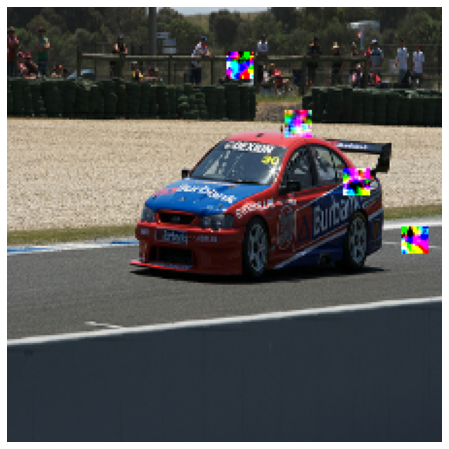

1/1 [==============================] - 0s 25ms/step
[[('n02930766', 'cab', 0.53293264), ('n04037443', 'racer', 0.17733496), ('n04285008', 'sports_car', 0.051688395), ('n02701002', 'ambulance', 0.044308253), ('n04461696', 'tow_truck', 0.019228915)]]
1/1 [==============================] - 3s 3s/step
[[('n06874185', 'traffic_light', 0.24232699), ('n04037443', 'racer', 0.14183548), ('n02930766', 'cab', 0.12020511), ('n04285008', 'sports_car', 0.03947995), ('n02814533', 'beach_wagon', 0.019492058)]]
1/1 [==============================] - 3s 3s/step
[[('n04037443', 'racer', 0.9267512), ('n04285008', 'sports_car', 0.02340303), ('n04461696', 'tow_truck', 0.016597925), ('n02930766', 'cab', 0.0133274235), ('n02701002', 'ambulance', 0.005091576)]]


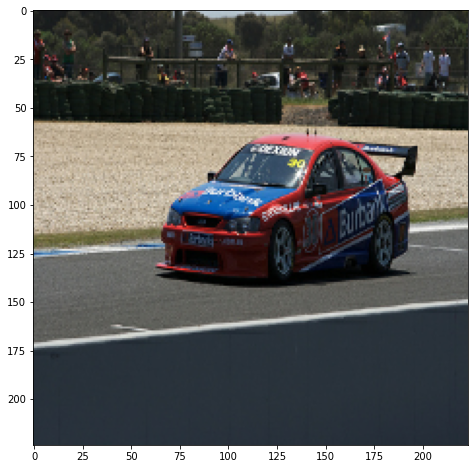

1/1 [==============================] - 0s 31ms/step
[[('n04037443', 'racer', 0.7650731), ('n04285008', 'sports_car', 0.05463957), ('n02930766', 'cab', 0.040202275), ('n03895866', 'passenger_car', 0.011915086), ('n03444034', 'go-kart', 0.009591491)]]
1/1 [==============================] - 0s 35ms/step
[[('n04037443', 'racer', 0.7967264), ('n04285008', 'sports_car', 0.062330026), ('n02974003', 'car_wheel', 0.016285263), ('n03895866', 'passenger_car', 0.014716523), ('n02930766', 'cab', 0.011689763)]]
1/1 [==============================] - 0s 31ms/step
[[('n04037443', 'racer', 0.9864543), ('n04285008', 'sports_car', 0.010833626), ('n03444034', 'go-kart', 0.0009612217), ('n02930766', 'cab', 0.0006212337), ('n02974003', 'car_wheel', 0.00038245117)]]
1/1 [==============================] - 0s 17ms/step
cab
1/1 [==============================] - 0s 20ms/step
0.53293264
1/1 [==============================] - 0s 16ms/step
racer
1/1 [==============================] - 0s 18ms/step
0.17733496
1/1 [=

  9%|▉         | 1/11 [01:23<13:53, 83.39s/it]

1/1 [==============================] - 0s 27ms/step
90
90
150
60
120
30
210
210


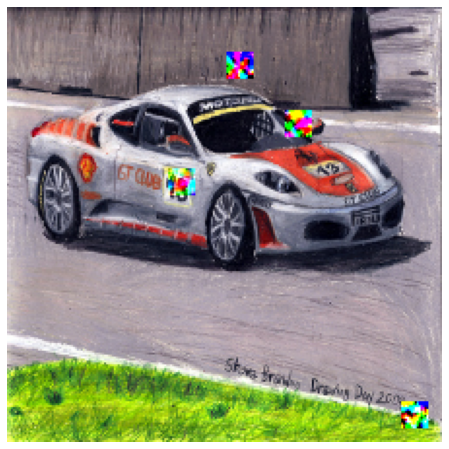

1/1 [==============================] - 0s 35ms/step
[[('n04037443', 'racer', 0.5627657), ('n04285008', 'sports_car', 0.2865226), ('n02974003', 'car_wheel', 0.024766685), ('n03444034', 'go-kart', 0.019637723), ('n02930766', 'cab', 0.0051959143)]]
1/1 [==============================] - 0s 46ms/step
[[('n04285008', 'sports_car', 0.21313694), ('n06874185', 'traffic_light', 0.14937294), ('n02930766', 'cab', 0.1358424), ('n04037443', 'racer', 0.10805092), ('n02974003', 'car_wheel', 0.059954286)]]
1/1 [==============================] - 0s 32ms/step
[[('n04285008', 'sports_car', 0.5092791), ('n04037443', 'racer', 0.4769006), ('n02974003', 'car_wheel', 0.00851705), ('n03444034', 'go-kart', 0.0012448777), ('n02930766', 'cab', 0.0012180958)]]


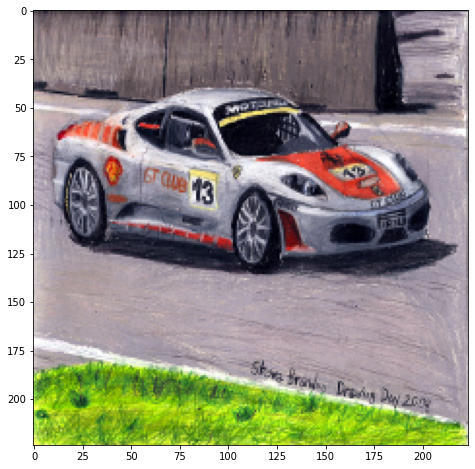

1/1 [==============================] - 0s 27ms/step
[[('n04037443', 'racer', 0.63311857), ('n04285008', 'sports_car', 0.29931113), ('n03444034', 'go-kart', 0.009645465), ('n02974003', 'car_wheel', 0.009424155), ('n03895866', 'passenger_car', 0.0022064692)]]
1/1 [==============================] - 0s 34ms/step
[[('n04037443', 'racer', 0.63499856), ('n04285008', 'sports_car', 0.23608376), ('n02974003', 'car_wheel', 0.025984412), ('n03895866', 'passenger_car', 0.010471608), ('n03444034', 'go-kart', 0.002015633)]]
1/1 [==============================] - 0s 30ms/step
[[('n04037443', 'racer', 0.8591342), ('n04285008', 'sports_car', 0.13907665), ('n02974003', 'car_wheel', 0.0010168256), ('n03444034', 'go-kart', 0.00039846543), ('n02930766', 'cab', 9.554455e-05)]]
1/1 [==============================] - 0s 19ms/step
racer
1/1 [==============================] - 0s 24ms/step
0.5627657
1/1 [==============================] - 0s 24ms/step
sports_car
1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 2/11 [01:48<07:20, 48.95s/it]

1/1 [==============================] - ETA: 0s

 18%|█▊        | 2/11 [02:00<09:02, 60.28s/it]


KeyboardInterrupt: ignored

In [ ]:
size = [14] #Need to check it goes through every combination of size and number. Also check that number = 1,2,3,4 (it's only 2 or 3)
#2,2,2,2,6,6,6,6,10,10,10,10,14,14,14,
number = 4
for i,size in enumerate(size):
  #All this stuff gets changed for each image
  real_label_index = 751 #Racer
  Obj = 'Car'
  #im1_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/imagenet_racer.JPEG")

  files = os.listdir("/content/gdrive/MyDrive/Data/DAR_data/Imagenet_racer")

  model = mobilenetv2
  x_value = []
  y_value = []
  size_val = []
  num_val = []
  conf_results = []
  imgclassmobilenetpet = []
  predsmobilenetpet = []
  imgclassmobilenetpet_top2 = []
  predsmobilenetpet_top2 = []
  imgclassmobilenetpet_top3 = []
  predsmobilenetpet_top3 = []
  imgclassnasnetpet = []
  predsnasnetpet = []
  imgclassnasnetpet_top2 = []
  predsnasnetpet_top2 = []
  imgclassnasnetpet_top3 = []
  predsnasnetpet_top3 = []
  imgclassdensenetpet = []
  predsdensenetpet = []  
  imgclassdensenetpet_top2 = []
  predsdensenetpet_top2 = []
  imgclassdensenetpet_top3 = []
  predsdensenetpet_top3 = []
  imgclassmobilenet = []
  predsmobilenet = []
  imgclassmobilenet_top2 = []
  predsmobilenet_top2 = []
  imgclassmobilenet_top3 = []
  predsmobilenet_top3 = []
  imgclassnasnet = []
  predsnasnet = []
  imgclassnasnet_top2 = []
  predsnasnet_top2 = []
  imgclassnasnet_top3 = []
  predsnasnet_top3 = []
  imgclassdensenet = []
  predsdensenet = []
  imgclassdensenet_top2 = []
  predsdensenet_top2 = []
  imgclassdensenet_top3 = []
  predsdensenet_top3 = []

# Figure out why locations aren't updating for some pictures, and why other models have same result
  for file in tqdm(files):
    #image path
    im1_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Imagenet_racer/{file}")
    im1 = tf.image.decode_image(im1_raw)
    image = preprocess(im1)

    adv_dar(image)
    include = [1]*len(x_value)
    create_adv_dars_auto(size,number)

    #Save results
    g = gen_mod_results() #Need to 'clean' results csv
    g.to_csv('/content/gdrive/MyDrive/Data/DAR_data/Results/cleanresults.csv', mode='a', sep='\t')
    d = gen_mod_results_pet()
    d.to_csv('/content/gdrive/MyDrive/Data/DAR_data/Results/petresults.csv', mode='a', sep='\t')
  
  if number <4:
    number = number+1
  else:
    number = 1

# Guitar


n02676566

In [ ]:
size = [2,2,2,2,6,6,6,6,10,10,10,10,14,14,14,14] #Need to check it goes through every combination of size and number. Also check that number = 1,2,3,4 (it's only 2 or 3)
number = 1
for i,size in enumerate(size):
  #All this stuff gets changed for each image
  real_label_index = 402 #Guitar
  Obj = 'Guitar'
  #im1_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/imagenet_racer.JPEG")

  files = os.listdir("/content/gdrive/MyDrive/Data/DAR_data/Imagenet_guitar")

  model = mobilenetv2
  x_value = []
  y_value = []
  size_val = []
  num_val = []
  conf_results = []
  imgclassmobilenetpet = []
  predsmobilenetpet = []
  imgclassmobilenetpet_top2 = []
  predsmobilenetpet_top2 = []
  imgclassmobilenetpet_top3 = []
  predsmobilenetpet_top3 = []
  imgclassnasnetpet = []
  predsnasnetpet = []
  imgclassnasnetpet_top2 = []
  predsnasnetpet_top2 = []
  imgclassnasnetpet_top3 = []
  predsnasnetpet_top3 = []
  imgclassdensenetpet = []
  predsdensenetpet = []  
  imgclassdensenetpet_top2 = []
  predsdensenetpet_top2 = []
  imgclassdensenetpet_top3 = []
  predsdensenetpet_top3 = []
  imgclassmobilenet = []
  predsmobilenet = []
  imgclassmobilenet_top2 = []
  predsmobilenet_top2 = []
  imgclassmobilenet_top3 = []
  predsmobilenet_top3 = []
  imgclassnasnet = []
  predsnasnet = []
  imgclassnasnet_top2 = []
  predsnasnet_top2 = []
  imgclassnasnet_top3 = []
  predsnasnet_top3 = []
  imgclassdensenet = []
  predsdensenet = []
  imgclassdensenet_top2 = []
  predsdensenet_top2 = []
  imgclassdensenet_top3 = []
  predsdensenet_top3 = []

# Figure out why locations aren't updating for some pictures, and why other models have same result
  for file in tqdm(files):
    #image path
    im1_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Imagenet_guitar/{file}")
    im1 = tf.image.decode_image(im1_raw)
    image = preprocess(im1)

    adv_dar(image)
    include = [1]*len(x_value)
    create_adv_dars_auto(size,number)

    #Save results
    g = gen_mod_results() #Need to 'clean' results csv
    g.to_csv('/content/gdrive/MyDrive/Data/DAR_data/Results/cleanresults.csv', mode='a', sep='\t')
    d = gen_mod_results_pet()
    d.to_csv('/content/gdrive/MyDrive/Data/DAR_data/Results/petresults.csv', mode='a', sep='\t')
  
  if number <4:
    number = number+1
  else:
    number = 1

# Frog

n01644900

In [ ]:
size = [2,2,2,2,6,6,6,6,10,10,10,10,14,14,14,14] #Need to check it goes through every combination of size and number. Also check that number = 1,2,3,4 (it's only 2 or 3)
number = 1
for i,size in enumerate(size):
  #All this stuff gets changed for each image
  real_label_index = 31 #Frog
  Obj = 'Frog'
  #im1_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/imagenet_racer.JPEG")

  files = os.listdir("/content/gdrive/MyDrive/Data/DAR_data/Imagenet_frog")

  model = mobilenetv2
  x_value = []
  y_value = []
  size_val = []
  num_val = []
  conf_results = []
  imgclassmobilenetpet = []
  predsmobilenetpet = []
  imgclassmobilenetpet_top2 = []
  predsmobilenetpet_top2 = []
  imgclassmobilenetpet_top3 = []
  predsmobilenetpet_top3 = []
  imgclassnasnetpet = []
  predsnasnetpet = []
  imgclassnasnetpet_top2 = []
  predsnasnetpet_top2 = []
  imgclassnasnetpet_top3 = []
  predsnasnetpet_top3 = []
  imgclassdensenetpet = []
  predsdensenetpet = []  
  imgclassdensenetpet_top2 = []
  predsdensenetpet_top2 = []
  imgclassdensenetpet_top3 = []
  predsdensenetpet_top3 = []
  imgclassmobilenet = []
  predsmobilenet = []
  imgclassmobilenet_top2 = []
  predsmobilenet_top2 = []
  imgclassmobilenet_top3 = []
  predsmobilenet_top3 = []
  imgclassnasnet = []
  predsnasnet = []
  imgclassnasnet_top2 = []
  predsnasnet_top2 = []
  imgclassnasnet_top3 = []
  predsnasnet_top3 = []
  imgclassdensenet = []
  predsdensenet = []
  imgclassdensenet_top2 = []
  predsdensenet_top2 = []
  imgclassdensenet_top3 = []
  predsdensenet_top3 = []

# Figure out why locations aren't updating for some pictures, and why other models have same result
  for file in tqdm(files):
    #image path
    im1_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Imagenet_frog/{file}")
    im1 = tf.image.decode_image(im1_raw)
    image = preprocess(im1)

    adv_dar(image)
    include = [1]*len(x_value)
    create_adv_dars_auto(size,number)

    #Save results
    g = gen_mod_results() #Need to 'clean' results csv
    g.to_csv('/content/gdrive/MyDrive/Data/DAR_data/Results/cleanresults.csv', mode='a', sep='\t')
    d = gen_mod_results_pet()
    d.to_csv('/content/gdrive/MyDrive/Data/DAR_data/Results/petresults.csv', mode='a', sep='\t')
  
  if number <4:
    number = number+1
  else:
    number = 1

# Beer

n02823428

In [ ]:
size = [2,2,2,2,6,6,6,6,10,10,10,10,14,14,14,14] #Need to check it goes through every combination of size and number. Also check that number = 1,2,3,4 (it's only 2 or 3)
number = 1
for i,size in enumerate(size):
  #All this stuff gets changed for each image
  real_label_index = 440 #Beer
  Obj = 'Beer'
  #im1_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/imagenet_racer.JPEG")

  files = os.listdir("/content/gdrive/MyDrive/Data/DAR_data/Imagenet_beer")

  model = mobilenetv2
  x_value = []
  y_value = []
  size_val = []
  num_val = []
  conf_results = []
  imgclassmobilenetpet = []
  predsmobilenetpet = []
  imgclassmobilenetpet_top2 = []
  predsmobilenetpet_top2 = []
  imgclassmobilenetpet_top3 = []
  predsmobilenetpet_top3 = []
  imgclassnasnetpet = []
  predsnasnetpet = []
  imgclassnasnetpet_top2 = []
  predsnasnetpet_top2 = []
  imgclassnasnetpet_top3 = []
  predsnasnetpet_top3 = []
  imgclassdensenetpet = []
  predsdensenetpet = []  
  imgclassdensenetpet_top2 = []
  predsdensenetpet_top2 = []
  imgclassdensenetpet_top3 = []
  predsdensenetpet_top3 = []
  imgclassmobilenet = []
  predsmobilenet = []
  imgclassmobilenet_top2 = []
  predsmobilenet_top2 = []
  imgclassmobilenet_top3 = []
  predsmobilenet_top3 = []
  imgclassnasnet = []
  predsnasnet = []
  imgclassnasnet_top2 = []
  predsnasnet_top2 = []
  imgclassnasnet_top3 = []
  predsnasnet_top3 = []
  imgclassdensenet = []
  predsdensenet = []
  imgclassdensenet_top2 = []
  predsdensenet_top2 = []
  imgclassdensenet_top3 = []
  predsdensenet_top3 = []

# Figure out why locations aren't updating for some pictures, and why other models have same result
  for file in tqdm(files):
    #image path
    im1_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Imagenet_beer/{file}")
    im1 = tf.image.decode_image(im1_raw)
    image = preprocess(im1)

    adv_dar(image)
    include = [1]*len(x_value)
    create_adv_dars_auto(size,number)

    #Save results
    g = gen_mod_results() #Need to 'clean' results csv
    g.to_csv('/content/gdrive/MyDrive/Data/DAR_data/Results/cleanresults.csv', mode='a', sep='\t')
    d = gen_mod_results_pet()
    d.to_csv('/content/gdrive/MyDrive/Data/DAR_data/Results/petresults.csv', mode='a', sep='\t')
  
  if number <4:
    number = number+1
  else:
    number = 1

# Tank

n04389033

In [ ]:
size = [2,2,2,2,6,6,6,6,10,10,10,10,14,14,14,14] #Need to check it goes through every combination of size and number. Also check that number = 1,2,3,4 (it's only 2 or 3)
number = 1
for i,size in enumerate(size):
  #All this stuff gets changed for each image
  real_label_index = 847 #Tank
  Obj = 'Tank'
  #im1_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/imagenet_racer.JPEG")

  files = os.listdir("/content/gdrive/MyDrive/Data/DAR_data/Imagenet_tank")

  model = mobilenetv2
  x_value = []
  y_value = []
  size_val = []
  num_val = []
  conf_results = []
  imgclassmobilenetpet = []
  predsmobilenetpet = []
  imgclassmobilenetpet_top2 = []
  predsmobilenetpet_top2 = []
  imgclassmobilenetpet_top3 = []
  predsmobilenetpet_top3 = []
  imgclassnasnetpet = []
  predsnasnetpet = []
  imgclassnasnetpet_top2 = []
  predsnasnetpet_top2 = []
  imgclassnasnetpet_top3 = []
  predsnasnetpet_top3 = []
  imgclassdensenetpet = []
  predsdensenetpet = []  
  imgclassdensenetpet_top2 = []
  predsdensenetpet_top2 = []
  imgclassdensenetpet_top3 = []
  predsdensenetpet_top3 = []
  imgclassmobilenet = []
  predsmobilenet = []
  imgclassmobilenet_top2 = []
  predsmobilenet_top2 = []
  imgclassmobilenet_top3 = []
  predsmobilenet_top3 = []
  imgclassnasnet = []
  predsnasnet = []
  imgclassnasnet_top2 = []
  predsnasnet_top2 = []
  imgclassnasnet_top3 = []
  predsnasnet_top3 = []
  imgclassdensenet = []
  predsdensenet = []
  imgclassdensenet_top2 = []
  predsdensenet_top2 = []
  imgclassdensenet_top3 = []
  predsdensenet_top3 = []

# Figure out why locations aren't updating for some pictures, and why other models have same result
  for file in tqdm(files):
    #image path
    im1_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Imagenet_tank/{file}")
    im1 = tf.image.decode_image(im1_raw)
    image = preprocess(im1)

    adv_dar(image)
    include = [1]*len(x_value)
    create_adv_dars_auto(size,number)

    #Save results
    g = gen_mod_results() #Need to 'clean' results csv
    g.to_csv('/content/gdrive/MyDrive/Data/DAR_data/Results/cleanresults.csv', mode='a', sep='\t')
    d = gen_mod_results_pet()
    d.to_csv('/content/gdrive/MyDrive/Data/DAR_data/Results/petresults.csv', mode='a', sep='\t')
  
  if number <4:
    number = number+1
  else:
    number = 1

# Ship

n03095699

  0%|          | 0/10 [00:00<?, ?it/s]

1/1 [==============================] - 0s 18ms/step


Only calculates 1-4 DARS


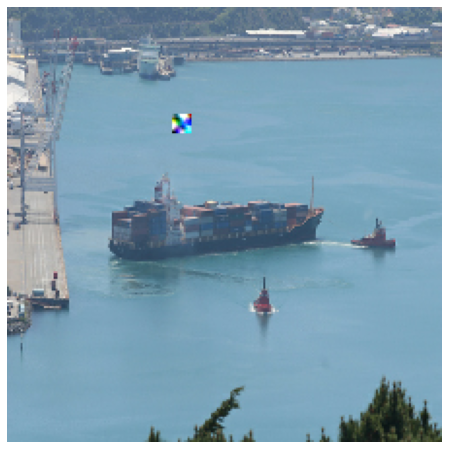

1/1 [==============================] - 0s 34ms/step
[[('n03095699', 'container_ship', 0.5982617), ('n03216828', 'dock', 0.078378044), ('n03673027', 'liner', 0.037714068), ('n03662601', 'lifeboat', 0.036977258), ('n03947888', 'pirate', 0.035548713)]]
1/1 [==============================] - 0s 35ms/step
[[('n03095699', 'container_ship', 0.82797116), ('n03216828', 'dock', 0.025209177), ('n02687172', 'aircraft_carrier', 0.019470716), ('n03240683', 'drilling_platform', 0.009037568), ('n03673027', 'liner', 0.0089480085)]]
1/1 [==============================] - 0s 33ms/step
[[('n03095699', 'container_ship', 0.8047726), ('n03240683', 'drilling_platform', 0.079038456), ('n03673027', 'liner', 0.043630496), ('n03216828', 'dock', 0.013347779), ('n03947888', 'pirate', 0.013017605)]]


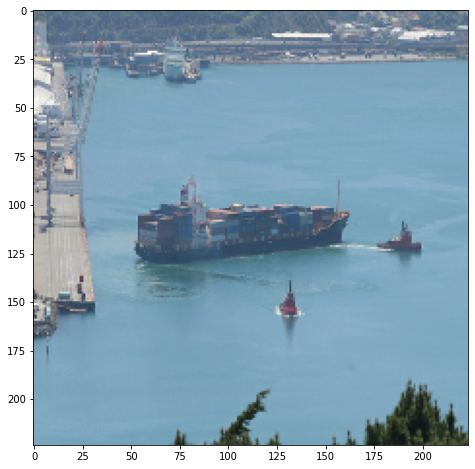

1/1 [==============================] - 0s 28ms/step
[[('n03095699', 'container_ship', 0.78223735), ('n03216828', 'dock', 0.048542347), ('n03673027', 'liner', 0.024140745), ('n04606251', 'wreck', 0.023428937), ('n03662601', 'lifeboat', 0.020365655)]]
1/1 [==============================] - 0s 38ms/step
[[('n03095699', 'container_ship', 0.91552174), ('n03216828', 'dock', 0.011323566), ('n03240683', 'drilling_platform', 0.004474279), ('n03673027', 'liner', 0.0033326943), ('n03126707', 'crane', 0.0027345712)]]
1/1 [==============================] - 0s 32ms/step
[[('n03095699', 'container_ship', 0.8569311), ('n03240683', 'drilling_platform', 0.06213683), ('n03673027', 'liner', 0.027860053), ('n03216828', 'dock', 0.010862873), ('n03947888', 'pirate', 0.010721225)]]
1/1 [==============================] - 0s 19ms/step
container_ship
1/1 [==============================] - 0s 23ms/step
0.5982617
1/1 [==============================] - 0s 18ms/step
dock
1/1 [==============================] - 0s 29m

 10%|█         | 1/10 [00:21<03:11, 21.32s/it]

1/1 [==============================] - 0s 19ms/step


Only calculates 1-4 DARS


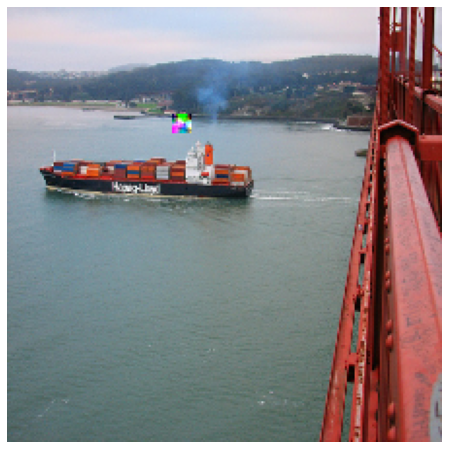

1/1 [==============================] - 0s 34ms/step
[[('n03095699', 'container_ship', 0.49893814), ('n03344393', 'fireboat', 0.40342984), ('n03662601', 'lifeboat', 0.025550187), ('n03933933', 'pier', 0.0086012585), ('n03874293', 'paddlewheel', 0.004150835)]]
1/1 [==============================] - 0s 39ms/step
[[('n03095699', 'container_ship', 0.922208), ('n03216828', 'dock', 0.012245003), ('n03662601', 'lifeboat', 0.0052609304), ('n03240683', 'drilling_platform', 0.0051348065), ('n03344393', 'fireboat', 0.004803689)]]
1/1 [==============================] - 0s 33ms/step
[[('n03095699', 'container_ship', 0.99801505), ('n03662601', 'lifeboat', 0.000755482), ('n03344393', 'fireboat', 0.00035426934), ('n03933933', 'pier', 0.00023124284), ('n03216828', 'dock', 0.00020169995)]]


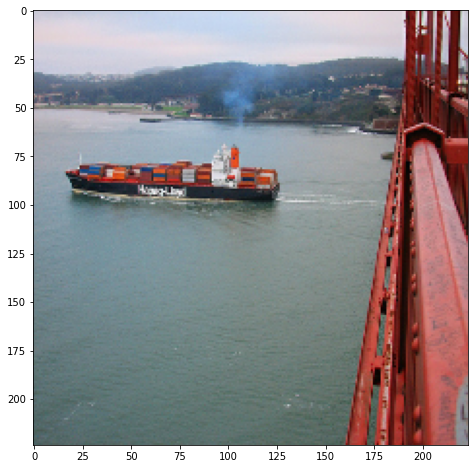

1/1 [==============================] - 0s 36ms/step
[[('n03095699', 'container_ship', 0.6712358), ('n03344393', 'fireboat', 0.17462455), ('n03662601', 'lifeboat', 0.04016742), ('n09332890', 'lakeside', 0.013037995), ('n03933933', 'pier', 0.011188816)]]
1/1 [==============================] - 0s 33ms/step
[[('n03095699', 'container_ship', 0.8478747), ('n03662601', 'lifeboat', 0.021614032), ('n03216828', 'dock', 0.011861247), ('n03344393', 'fireboat', 0.0062176026), ('n03240683', 'drilling_platform', 0.0055907853)]]
1/1 [==============================] - 0s 30ms/step
[[('n03095699', 'container_ship', 0.9955205), ('n03662601', 'lifeboat', 0.0027789776), ('n03344393', 'fireboat', 0.00084470224), ('n03216828', 'dock', 0.00018764369), ('n03933933', 'pier', 0.00012920125)]]
1/1 [==============================] - 0s 18ms/step
container_ship
1/1 [==============================] - 0s 24ms/step
0.49893814
1/1 [==============================] - 0s 26ms/step
fireboat
1/1 [===========================

 20%|██        | 2/10 [00:40<02:39, 19.98s/it]

1/1 [==============================] - 0s 18ms/step


Only calculates 1-4 DARS


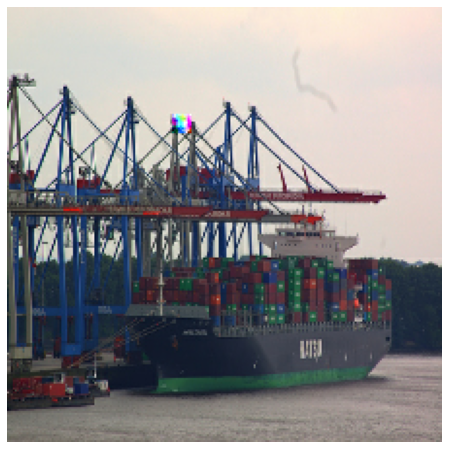

1/1 [==============================] - 0s 33ms/step
[[('n03095699', 'container_ship', 0.948167), ('n03216828', 'dock', 0.008885599), ('n03240683', 'drilling_platform', 0.0081559215), ('n03126707', 'crane', 0.0011266674), ('n03947888', 'pirate', 0.00068820186)]]
1/1 [==============================] - 0s 34ms/step
[[('n03095699', 'container_ship', 0.8552637), ('n03216828', 'dock', 0.0059589017), ('n03673027', 'liner', 0.0021472974), ('n02276258', 'admiral', 0.0016980253), ('n04606251', 'wreck', 0.0014098145)]]
1/1 [==============================] - 0s 30ms/step
[[('n03095699', 'container_ship', 0.9999963), ('n03126707', 'crane', 1.6253846e-06), ('n03933933', 'pier', 6.866675e-07), ('n03673027', 'liner', 6.210675e-07), ('n03240683', 'drilling_platform', 1.9023132e-07)]]


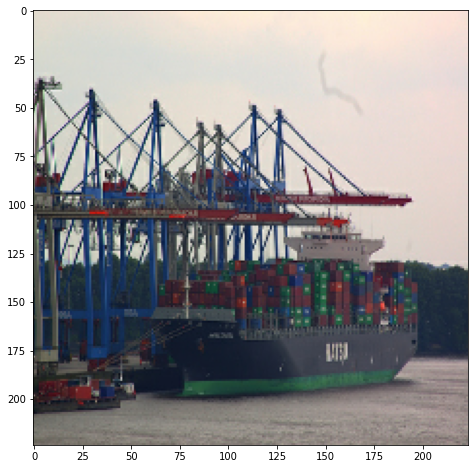

1/1 [==============================] - 0s 56ms/step
[[('n03095699', 'container_ship', 0.9612319), ('n03216828', 'dock', 0.004091908), ('n03240683', 'drilling_platform', 0.0039012542), ('n03126707', 'crane', 0.0005364778), ('n03947888', 'pirate', 0.00051035784)]]
1/1 [==============================] - 0s 40ms/step
[[('n03095699', 'container_ship', 0.8649383), ('n03216828', 'dock', 0.007409305), ('n03673027', 'liner', 0.0024012423), ('n02276258', 'admiral', 0.0014606745), ('n03240683', 'drilling_platform', 0.0013118742)]]
1/1 [==============================] - 0s 31ms/step
[[('n03095699', 'container_ship', 0.9999968), ('n03126707', 'crane', 1.152884e-06), ('n03673027', 'liner', 6.476234e-07), ('n03933933', 'pier', 5.6155795e-07), ('n03216828', 'dock', 2.6035173e-07)]]
1/1 [==============================] - 0s 28ms/step
container_ship
1/1 [==============================] - 0s 29ms/step
0.948167
1/1 [==============================] - 0s 23ms/step
dock
1/1 [==============================] -

 30%|███       | 3/10 [00:59<02:18, 19.82s/it]

1/1 [==============================] - 0s 17ms/step


Only calculates 1-4 DARS


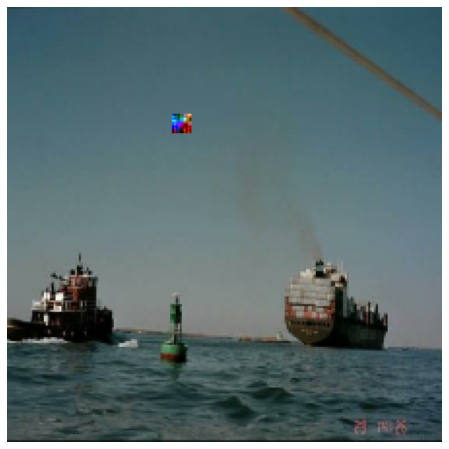

1/1 [==============================] - 0s 27ms/step
[[('n03095699', 'container_ship', 0.7022679), ('n02692877', 'airship', 0.035694983), ('n03240683', 'drilling_platform', 0.03354743), ('n03344393', 'fireboat', 0.031907555), ('n03888257', 'parachute', 0.029944645)]]
1/1 [==============================] - 0s 35ms/step
[[('n03240683', 'drilling_platform', 0.44201294), ('n06874185', 'traffic_light', 0.04812876), ('n03126707', 'crane', 0.035796918), ('n02687172', 'aircraft_carrier', 0.032302074), ('n03673027', 'liner', 0.031268187)]]
1/1 [==============================] - 0s 40ms/step
[[('n03240683', 'drilling_platform', 0.5386355), ('n03095699', 'container_ship', 0.28420556), ('n03673027', 'liner', 0.05969231), ('n03947888', 'pirate', 0.022567607), ('n04606251', 'wreck', 0.01762858)]]


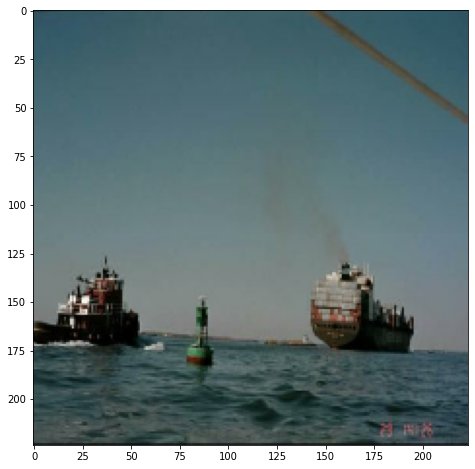

1/1 [==============================] - 0s 28ms/step
[[('n03095699', 'container_ship', 0.94510424), ('n03344393', 'fireboat', 0.012874535), ('n04606251', 'wreck', 0.010071996), ('n03240683', 'drilling_platform', 0.009773324), ('n03673027', 'liner', 0.0036565913)]]
1/1 [==============================] - 0s 34ms/step
[[('n03240683', 'drilling_platform', 0.9633363), ('n03126707', 'crane', 0.0031574848), ('n04606251', 'wreck', 0.0027430283), ('n03095699', 'container_ship', 0.001958542), ('n04347754', 'submarine', 0.0012365117)]]
1/1 [==============================] - 0s 31ms/step
[[('n03240683', 'drilling_platform', 0.6133459), ('n03095699', 'container_ship', 0.27614626), ('n03673027', 'liner', 0.04537055), ('n04606251', 'wreck', 0.013295912), ('n03947888', 'pirate', 0.010990065)]]
1/1 [==============================] - 0s 20ms/step
container_ship
1/1 [==============================] - 0s 30ms/step
0.7022679
1/1 [==============================] - 0s 36ms/step
airship
1/1 [==================

 40%|████      | 4/10 [01:20<01:59, 19.91s/it]

1/1 [==============================] - 0s 20ms/step


Only calculates 1-4 DARS


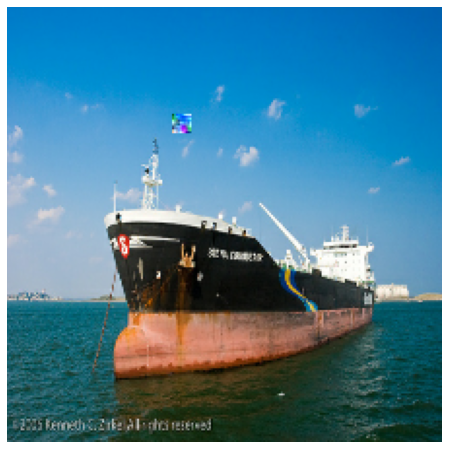

1/1 [==============================] - 0s 31ms/step
[[('n03095699', 'container_ship', 0.32502535), ('n03673027', 'liner', 0.20867707), ('n04606251', 'wreck', 0.20161836), ('n03240683', 'drilling_platform', 0.04885033), ('n02687172', 'aircraft_carrier', 0.046224434)]]
1/1 [==============================] - 0s 38ms/step
[[('n03673027', 'liner', 0.47449034), ('n03095699', 'container_ship', 0.2659631), ('n03216828', 'dock', 0.050600693), ('n04347754', 'submarine', 0.012217267), ('n02687172', 'aircraft_carrier', 0.009950018)]]
1/1 [==============================] - 0s 43ms/step
[[('n03095699', 'container_ship', 0.7961999), ('n03673027', 'liner', 0.14753957), ('n04606251', 'wreck', 0.023815406), ('n03216828', 'dock', 0.014424552), ('n03240683', 'drilling_platform', 0.0026296102)]]


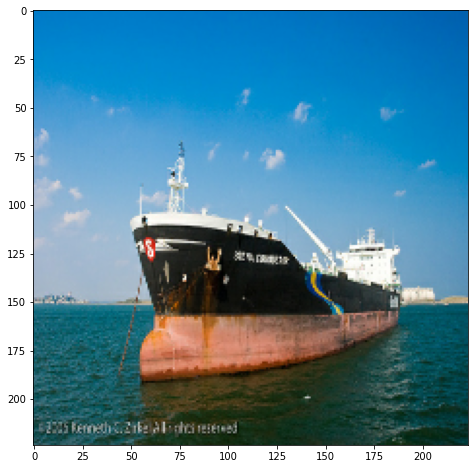

1/1 [==============================] - 0s 27ms/step
[[('n03095699', 'container_ship', 0.4567863), ('n04606251', 'wreck', 0.1699646), ('n03673027', 'liner', 0.15268254), ('n03240683', 'drilling_platform', 0.042450096), ('n03344393', 'fireboat', 0.03321149)]]
1/1 [==============================] - 0s 51ms/step
[[('n03673027', 'liner', 0.5125075), ('n03095699', 'container_ship', 0.21053386), ('n03216828', 'dock', 0.05656202), ('n04347754', 'submarine', 0.012149344), ('n04606251', 'wreck', 0.008425073)]]
1/1 [==============================] - 0s 46ms/step
[[('n03095699', 'container_ship', 0.8450342), ('n03673027', 'liner', 0.1057037), ('n04606251', 'wreck', 0.021284007), ('n03216828', 'dock', 0.013890507), ('n03240683', 'drilling_platform', 0.0032624581)]]
1/1 [==============================] - 0s 17ms/step
container_ship
1/1 [==============================] - 0s 27ms/step
0.32502535
1/1 [==============================] - 0s 29ms/step
liner
1/1 [==============================] - 0s 25ms/st

 50%|█████     | 5/10 [01:40<01:39, 19.99s/it]

1/1 [==============================] - 0s 17ms/step


Only calculates 1-4 DARS


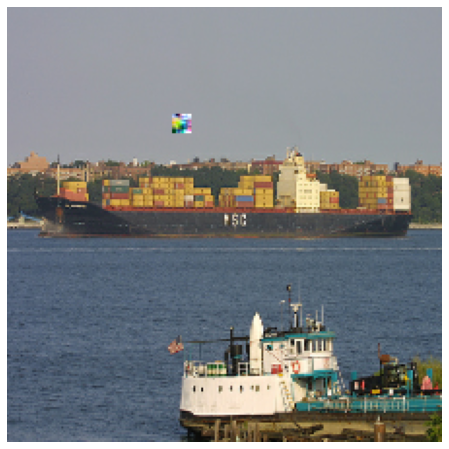

1/1 [==============================] - 0s 29ms/step
[[('n03095699', 'container_ship', 0.982667), ('n03216828', 'dock', 0.0009014918), ('n03240683', 'drilling_platform', 0.0008597162), ('n03673027', 'liner', 0.0005762948), ('n03662601', 'lifeboat', 0.00034680052)]]
1/1 [==============================] - 0s 44ms/step
[[('n03095699', 'container_ship', 0.91009927), ('n03673027', 'liner', 0.0033274062), ('n03216828', 'dock', 0.0020930027), ('n04606251', 'wreck', 0.001331965), ('n02276258', 'admiral', 0.0012970774)]]
1/1 [==============================] - 0s 42ms/step
[[('n03095699', 'container_ship', 0.9998528), ('n03673027', 'liner', 0.00010745601), ('n03216828', 'dock', 1.4294533e-05), ('n03240683', 'drilling_platform', 6.1050764e-06), ('n02894605', 'breakwater', 2.038787e-06)]]


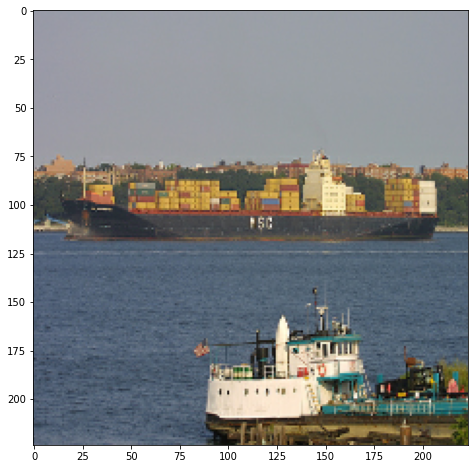

1/1 [==============================] - 0s 34ms/step
[[('n03095699', 'container_ship', 0.9782981), ('n03240683', 'drilling_platform', 0.0007378351), ('n03673027', 'liner', 0.0006680444), ('n03216828', 'dock', 0.0005437317), ('n03662601', 'lifeboat', 0.000511443)]]
1/1 [==============================] - 0s 52ms/step
[[('n03095699', 'container_ship', 0.9073195), ('n03673027', 'liner', 0.0031568464), ('n03216828', 'dock', 0.0027262813), ('n02276258', 'admiral', 0.0014682512), ('n04606251', 'wreck', 0.0010309494)]]
1/1 [==============================] - 0s 41ms/step
[[('n03095699', 'container_ship', 0.9999348), ('n03673027', 'liner', 4.2062078e-05), ('n03216828', 'dock', 8.969765e-06), ('n03240683', 'drilling_platform', 3.865818e-06), ('n09399592', 'promontory', 1.6154302e-06)]]
1/1 [==============================] - 0s 26ms/step
container_ship
1/1 [==============================] - 0s 26ms/step
0.982667
1/1 [==============================] - 0s 24ms/step
dock
1/1 [=========================

 60%|██████    | 6/10 [02:00<01:20, 20.09s/it]

1/1 [==============================] - 0s 18ms/step


Only calculates 1-4 DARS


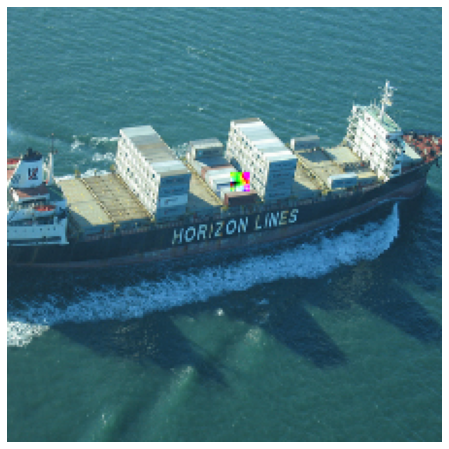

1/1 [==============================] - 0s 51ms/step
[[('n04273569', 'speedboat', 0.28503433), ('n02687172', 'aircraft_carrier', 0.15480533), ('n03095699', 'container_ship', 0.07942425), ('n03447447', 'gondola', 0.0652948), ('n04606251', 'wreck', 0.06065861)]]
1/1 [==============================] - 0s 52ms/step
[[('n03095699', 'container_ship', 0.786308), ('n02687172', 'aircraft_carrier', 0.04105498), ('n04273569', 'speedboat', 0.03628793), ('n03344393', 'fireboat', 0.009673824), ('n03216828', 'dock', 0.009270947)]]
1/1 [==============================] - 0s 51ms/step
[[('n03095699', 'container_ship', 0.9422608), ('n03216828', 'dock', 0.032000788), ('n09332890', 'lakeside', 0.007818227), ('n02859443', 'boathouse', 0.004474567), ('n04606251', 'wreck', 0.0019261875)]]


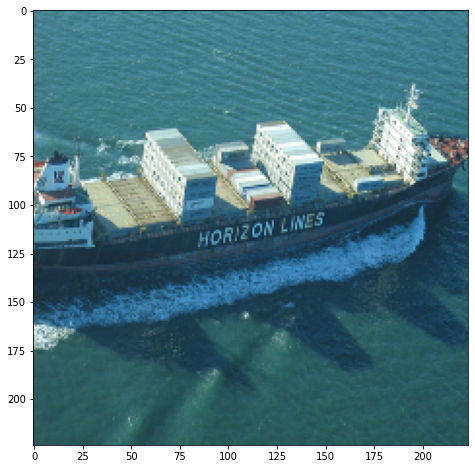

1/1 [==============================] - 0s 34ms/step
[[('n03095699', 'container_ship', 0.16412498), ('n02687172', 'aircraft_carrier', 0.142557), ('n03447447', 'gondola', 0.13100724), ('n04273569', 'speedboat', 0.11923334), ('n03216828', 'dock', 0.04782132)]]
1/1 [==============================] - 0s 50ms/step
[[('n03095699', 'container_ship', 0.92158645), ('n04273569', 'speedboat', 0.005408143), ('n02687172', 'aircraft_carrier', 0.0030365402), ('n03216828', 'dock', 0.0029466753), ('n04606251', 'wreck', 0.002254509)]]
1/1 [==============================] - 0s 43ms/step
[[('n03095699', 'container_ship', 0.90875417), ('n03216828', 'dock', 0.04617491), ('n09332890', 'lakeside', 0.020282762), ('n02859443', 'boathouse', 0.008013763), ('n02894605', 'breakwater', 0.0023403352)]]
1/1 [==============================] - 0s 28ms/step
speedboat
1/1 [==============================] - 0s 35ms/step
0.28503433
1/1 [==============================] - 0s 30ms/step
aircraft_carrier
1/1 [====================

 70%|███████   | 7/10 [02:21<01:00, 20.29s/it]

1/1 [==============================] - 0s 17ms/step


Only calculates 1-4 DARS


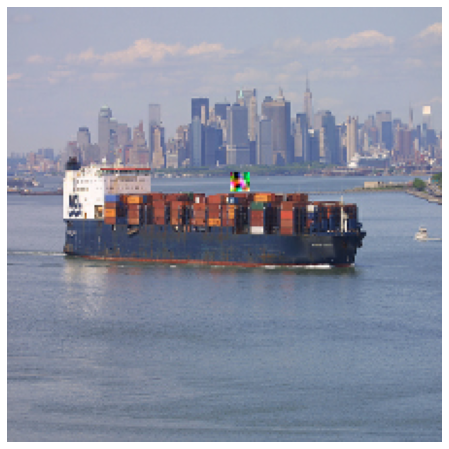

1/1 [==============================] - 0s 31ms/step
[[('n03095699', 'container_ship', 0.93068993), ('n03216828', 'dock', 0.010300231), ('n03662601', 'lifeboat', 0.0059649046), ('n03240683', 'drilling_platform', 0.0051659425), ('n03673027', 'liner', 0.0033183377)]]
1/1 [==============================] - 0s 63ms/step
[[('n03095699', 'container_ship', 0.8892133), ('n02276258', 'admiral', 0.005167684), ('n04606251', 'wreck', 0.0027353673), ('n03673027', 'liner', 0.0015263886), ('n03216828', 'dock', 0.0011023534)]]
1/1 [==============================] - 0s 46ms/step
[[('n03095699', 'container_ship', 0.99991596), ('n03216828', 'dock', 3.9104874e-05), ('n03673027', 'liner', 1.4074907e-05), ('n03240683', 'drilling_platform', 7.306689e-06), ('n04606251', 'wreck', 4.23659e-06)]]


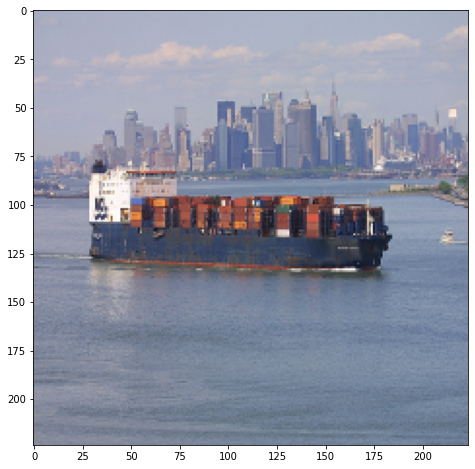

1/1 [==============================] - 0s 44ms/step
[[('n03095699', 'container_ship', 0.9499949), ('n03216828', 'dock', 0.009588506), ('n03673027', 'liner', 0.00330172), ('n03240683', 'drilling_platform', 0.0026604063), ('n03933933', 'pier', 0.0025635664)]]
1/1 [==============================] - 0s 56ms/step
[[('n03095699', 'container_ship', 0.89696187), ('n02276258', 'admiral', 0.0039836424), ('n04606251', 'wreck', 0.001868453), ('n03673027', 'liner', 0.0018345836), ('n03216828', 'dock', 0.00135046)]]
1/1 [==============================] - 0s 85ms/step
[[('n03095699', 'container_ship', 0.9997851), ('n03216828', 'dock', 9.6382304e-05), ('n03673027', 'liner', 4.2549003e-05), ('n04606251', 'wreck', 1.7425413e-05), ('n03933933', 'pier', 1.6690406e-05)]]
1/1 [==============================] - 0s 36ms/step
container_ship
1/1 [==============================] - 0s 36ms/step
0.93068993
1/1 [==============================] - 0s 35ms/step
dock
1/1 [==============================] - 0s 38ms/step


 80%|████████  | 8/10 [02:45<00:42, 21.45s/it]

1/1 [==============================] - 0s 19ms/step


Only calculates 1-4 DARS


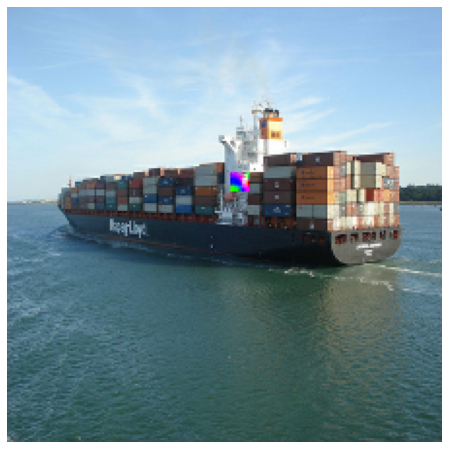

1/1 [==============================] - 0s 44ms/step
[[('n03095699', 'container_ship', 0.876136), ('n03673027', 'liner', 0.002476646), ('n03662601', 'lifeboat', 0.0015915879), ('n04606251', 'wreck', 0.0015491672), ('n03216828', 'dock', 0.00092764205)]]
1/1 [==============================] - 0s 80ms/step
[[('n03095699', 'container_ship', 0.92386174), ('n02276258', 'admiral', 0.0021799444), ('n03216828', 'dock', 0.00088043284), ('n03673027', 'liner', 0.0006282294), ('n02281787', 'lycaenid', 0.0004911215)]]
1/1 [==============================] - 0s 50ms/step
[[('n03095699', 'container_ship', 1.0), ('n03673027', 'liner', 1.8092386e-09), ('n03216828', 'dock', 3.3230677e-10), ('n02509815', 'lesser_panda', 2.1263129e-10), ('n03947888', 'pirate', 2.0040308e-10)]]


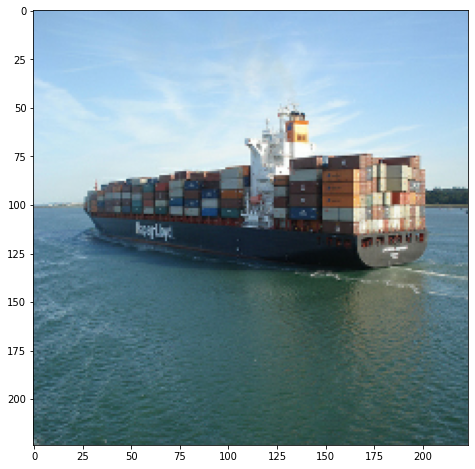

1/1 [==============================] - 0s 29ms/step
[[('n03095699', 'container_ship', 0.8368208), ('n03673027', 'liner', 0.0037700343), ('n03662601', 'lifeboat', 0.0023094907), ('n04606251', 'wreck', 0.0022471277), ('n03216828', 'dock', 0.0010575803)]]
1/1 [==============================] - 0s 64ms/step
[[('n03095699', 'container_ship', 0.9075345), ('n02276258', 'admiral', 0.003104096), ('n02281787', 'lycaenid', 0.0014696618), ('n03216828', 'dock', 0.001322569), ('n03673027', 'liner', 0.0007130823)]]
1/1 [==============================] - 0s 44ms/step
[[('n03095699', 'container_ship', 1.0), ('n03673027', 'liner', 6.741111e-10), ('n02509815', 'lesser_panda', 1.2547437e-10), ('n03240683', 'drilling_platform', 6.466386e-11), ('n03216828', 'dock', 6.289782e-11)]]
1/1 [==============================] - 0s 28ms/step
container_ship
1/1 [==============================] - 0s 25ms/step
0.876136
1/1 [==============================] - 0s 24ms/step
liner
1/1 [==============================] - 0s 24

 90%|█████████ | 9/10 [03:07<00:21, 21.91s/it]

1/1 [==============================] - 0s 18ms/step


Only calculates 1-4 DARS


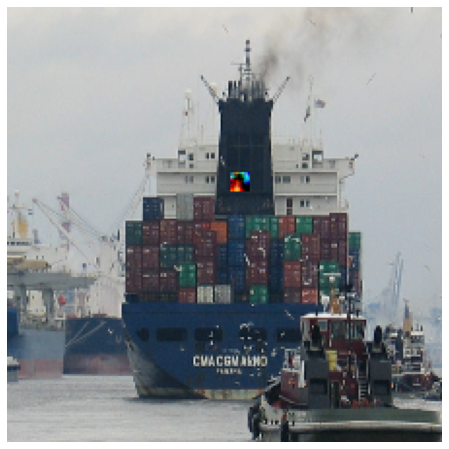

1/1 [==============================] - 0s 29ms/step
[[('n03095699', 'container_ship', 0.895535), ('n03240683', 'drilling_platform', 0.0060596545), ('n02687172', 'aircraft_carrier', 0.004778555), ('n03344393', 'fireboat', 0.004371756), ('n04347754', 'submarine', 0.0033564118)]]
1/1 [==============================] - 0s 59ms/step
[[('n03095699', 'container_ship', 0.912579), ('n03216828', 'dock', 0.0030891218), ('n02276258', 'admiral', 0.0017510273), ('n03673027', 'liner', 0.0012831074), ('n02281787', 'lycaenid', 0.0009126455)]]
1/1 [==============================] - 0s 48ms/step
[[('n03095699', 'container_ship', 0.9999993), ('n03216828', 'dock', 5.132878e-07), ('n03673027', 'liner', 1.9997692e-07), ('n03947888', 'pirate', 8.453665e-09), ('n03344393', 'fireboat', 6.8301143e-09)]]


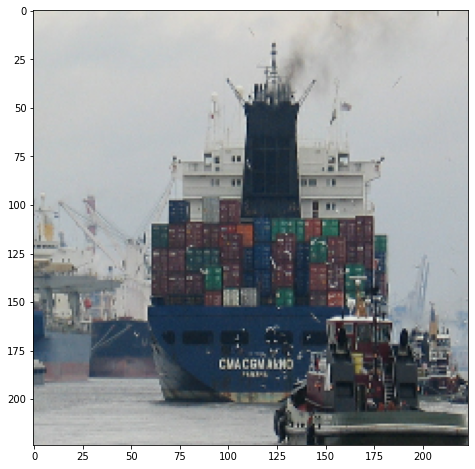

1/1 [==============================] - 0s 27ms/step
[[('n03095699', 'container_ship', 0.9146652), ('n03344393', 'fireboat', 0.007662642), ('n02687172', 'aircraft_carrier', 0.005135867), ('n03240683', 'drilling_platform', 0.0044340068), ('n03216828', 'dock', 0.003215988)]]
1/1 [==============================] - 0s 54ms/step
[[('n03095699', 'container_ship', 0.8899288), ('n03216828', 'dock', 0.002993511), ('n02276258', 'admiral', 0.0027163874), ('n02281787', 'lycaenid', 0.0018605008), ('n03673027', 'liner', 0.0014001953)]]
1/1 [==============================] - 0s 48ms/step
[[('n03095699', 'container_ship', 0.99999964), ('n03216828', 'dock', 2.1040759e-07), ('n03673027', 'liner', 1.0218571e-07), ('n03344393', 'fireboat', 4.5439323e-09), ('n03240683', 'drilling_platform', 4.3427453e-09)]]
1/1 [==============================] - 0s 32ms/step
container_ship
1/1 [==============================] - 0s 25ms/step
0.895535
1/1 [==============================] - 0s 24ms/step
drilling_platform
1/1 [

  0%|          | 0/10 [00:00<?, ?it/s]

1/1 [==============================] - 0s 27ms/step


Only calculates 1-4 DARS


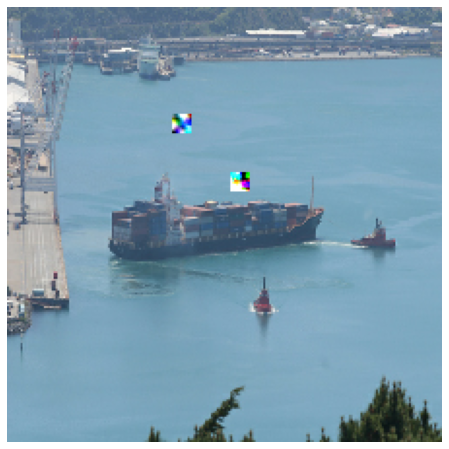

1/1 [==============================] - 0s 32ms/step
[[('n03947888', 'pirate', 0.23139217), ('n03216828', 'dock', 0.16077562), ('n03095699', 'container_ship', 0.13572302), ('n03662601', 'lifeboat', 0.050643276), ('n03673027', 'liner', 0.04560667)]]
1/1 [==============================] - 0s 62ms/step
[[('n03673027', 'liner', 0.72470605), ('n03216828', 'dock', 0.04300874), ('n03095699', 'container_ship', 0.03967036), ('n02687172', 'aircraft_carrier', 0.024441574), ('n03933933', 'pier', 0.017268647)]]
1/1 [==============================] - 0s 47ms/step
[[('n03095699', 'container_ship', 0.83569247), ('n03673027', 'liner', 0.09444306), ('n03240683', 'drilling_platform', 0.01764702), ('n03216828', 'dock', 0.011718793), ('n03344393', 'fireboat', 0.008846035)]]


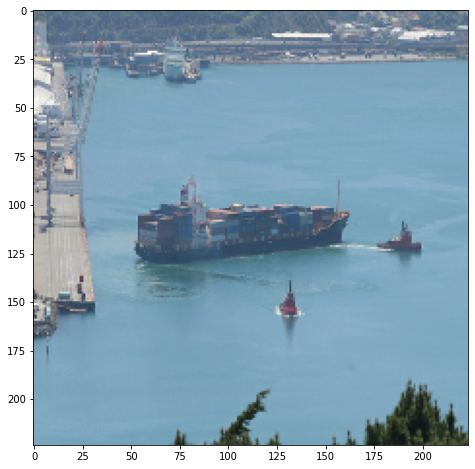

1/1 [==============================] - 0s 28ms/step
[[('n03095699', 'container_ship', 0.78223735), ('n03216828', 'dock', 0.048542347), ('n03673027', 'liner', 0.024140745), ('n04606251', 'wreck', 0.023428937), ('n03662601', 'lifeboat', 0.020365655)]]
1/1 [==============================] - 0s 56ms/step
[[('n03095699', 'container_ship', 0.91552174), ('n03216828', 'dock', 0.011323566), ('n03240683', 'drilling_platform', 0.004474279), ('n03673027', 'liner', 0.0033326943), ('n03126707', 'crane', 0.0027345712)]]
1/1 [==============================] - 0s 46ms/step
[[('n03095699', 'container_ship', 0.8569311), ('n03240683', 'drilling_platform', 0.06213683), ('n03673027', 'liner', 0.027860053), ('n03216828', 'dock', 0.010862873), ('n03947888', 'pirate', 0.010721225)]]
1/1 [==============================] - 0s 30ms/step
pirate
1/1 [==============================] - 0s 27ms/step
0.23139217
1/1 [==============================] - 0s 27ms/step
dock
1/1 [==============================] - 0s 37ms/step


 10%|█         | 1/10 [00:25<03:47, 25.28s/it]

1/1 [==============================] - 0s 26ms/step


Only calculates 1-4 DARS


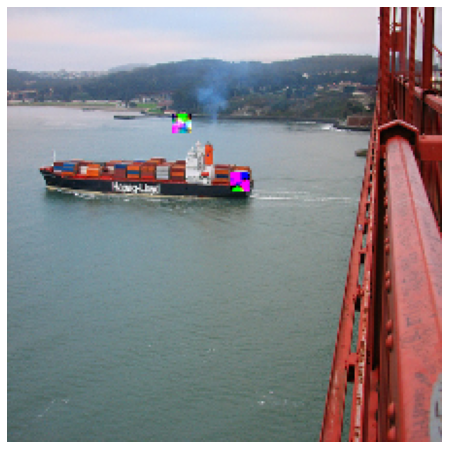

1/1 [==============================] - 0s 29ms/step
[[('n03095699', 'container_ship', 0.65933144), ('n03344393', 'fireboat', 0.24969353), ('n03662601', 'lifeboat', 0.016987646), ('n03933933', 'pier', 0.012663394), ('n09332890', 'lakeside', 0.004772488)]]
1/1 [==============================] - 0s 66ms/step
[[('n03216828', 'dock', 0.43141437), ('n03095699', 'container_ship', 0.17665592), ('n03933933', 'pier', 0.04825342), ('n03662601', 'lifeboat', 0.04601388), ('n02859443', 'boathouse', 0.0446635)]]
1/1 [==============================] - 0s 52ms/step
[[('n03095699', 'container_ship', 0.9956584), ('n03662601', 'lifeboat', 0.0011637555), ('n03933933', 'pier', 0.001064196), ('n03344393', 'fireboat', 0.0007253713), ('n03216828', 'dock', 0.00025838098)]]


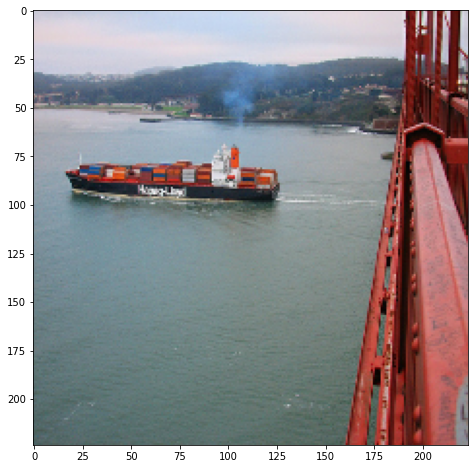

1/1 [==============================] - 0s 28ms/step
[[('n03095699', 'container_ship', 0.6712358), ('n03344393', 'fireboat', 0.17462455), ('n03662601', 'lifeboat', 0.04016742), ('n09332890', 'lakeside', 0.013037995), ('n03933933', 'pier', 0.011188816)]]
1/1 [==============================] - 0s 51ms/step
[[('n03095699', 'container_ship', 0.8478747), ('n03662601', 'lifeboat', 0.021614032), ('n03216828', 'dock', 0.011861247), ('n03344393', 'fireboat', 0.0062176026), ('n03240683', 'drilling_platform', 0.0055907853)]]
1/1 [==============================] - 0s 71ms/step
[[('n03095699', 'container_ship', 0.9955205), ('n03662601', 'lifeboat', 0.0027789776), ('n03344393', 'fireboat', 0.00084470224), ('n03216828', 'dock', 0.00018764369), ('n03933933', 'pier', 0.00012920125)]]
1/1 [==============================] - 0s 28ms/step
container_ship
1/1 [==============================] - 0s 24ms/step
0.65933144
1/1 [==============================] - 0s 24ms/step
fireboat
1/1 [===========================

 20%|██        | 2/10 [00:50<03:22, 25.37s/it]

1/1 [==============================] - 0s 27ms/step


Only calculates 1-4 DARS


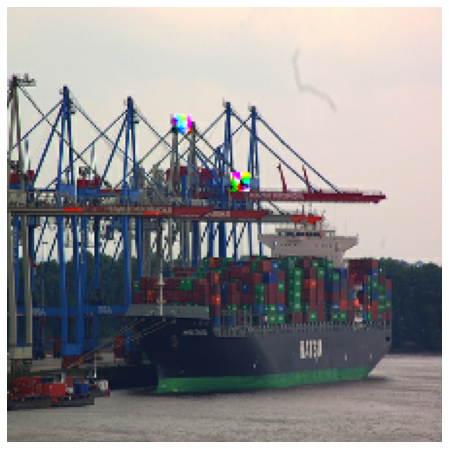

1/1 [==============================] - 0s 25ms/step
[[('n03095699', 'container_ship', 0.9481268), ('n03240683', 'drilling_platform', 0.017178169), ('n03216828', 'dock', 0.008776189), ('n03947888', 'pirate', 0.0011232643), ('n03126707', 'crane', 0.00075436675)]]
1/1 [==============================] - 0s 48ms/step
[[('n03095699', 'container_ship', 0.8486079), ('n06874185', 'traffic_light', 0.010549559), ('n03933933', 'pier', 0.007066693), ('n03216828', 'dock', 0.0058322432), ('n03673027', 'liner', 0.0028392982)]]
1/1 [==============================] - 0s 53ms/step
[[('n03095699', 'container_ship', 0.9999591), ('n03126707', 'crane', 1.4171753e-05), ('n03933933', 'pier', 1.32925015e-05), ('n03673027', 'liner', 5.0143394e-06), ('n03216828', 'dock', 2.771591e-06)]]


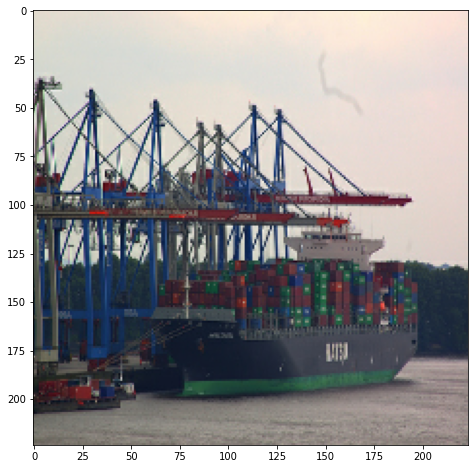

1/1 [==============================] - 0s 27ms/step
[[('n03095699', 'container_ship', 0.9612319), ('n03216828', 'dock', 0.004091908), ('n03240683', 'drilling_platform', 0.0039012542), ('n03126707', 'crane', 0.0005364778), ('n03947888', 'pirate', 0.00051035784)]]
1/1 [==============================] - 0s 54ms/step
[[('n03095699', 'container_ship', 0.8649383), ('n03216828', 'dock', 0.007409305), ('n03673027', 'liner', 0.0024012423), ('n02276258', 'admiral', 0.0014606745), ('n03240683', 'drilling_platform', 0.0013118742)]]
1/1 [==============================] - 0s 50ms/step
[[('n03095699', 'container_ship', 0.9999968), ('n03126707', 'crane', 1.152884e-06), ('n03673027', 'liner', 6.476234e-07), ('n03933933', 'pier', 5.6155795e-07), ('n03216828', 'dock', 2.6035173e-07)]]
1/1 [==============================] - 0s 26ms/step
container_ship
1/1 [==============================] - 0s 27ms/step
0.9481268
1/1 [==============================] - 0s 24ms/step
drilling_platform
1/1 [===================

 30%|███       | 3/10 [01:17<03:00, 25.82s/it]

1/1 [==============================] - 0s 26ms/step


Only calculates 1-4 DARS


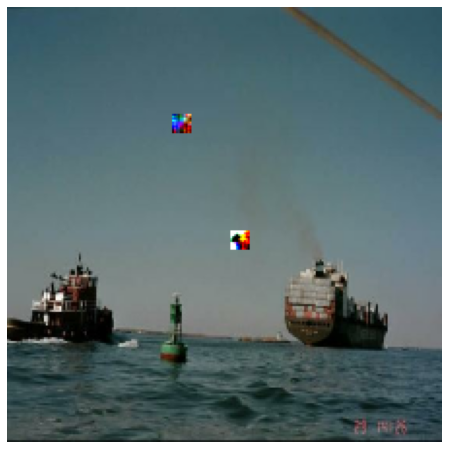

1/1 [==============================] - 0s 36ms/step
[[('n03095699', 'container_ship', 0.66596246), ('n03240683', 'drilling_platform', 0.06058374), ('n03888257', 'parachute', 0.025836628), ('n03344393', 'fireboat', 0.025036393), ('n02692877', 'airship', 0.022281146)]]
1/1 [==============================] - 0s 49ms/step
[[('n06874185', 'traffic_light', 0.63172674), ('n02782093', 'balloon', 0.08886993), ('n03888257', 'parachute', 0.026740272), ('n03240683', 'drilling_platform', 0.0067656394), ('n02692877', 'airship', 0.0061213756)]]
1/1 [==============================] - 0s 59ms/step
[[('n03240683', 'drilling_platform', 0.4996509), ('n03095699', 'container_ship', 0.31627598), ('n03673027', 'liner', 0.09852099), ('n04606251', 'wreck', 0.011634162), ('n02687172', 'aircraft_carrier', 0.011151478)]]


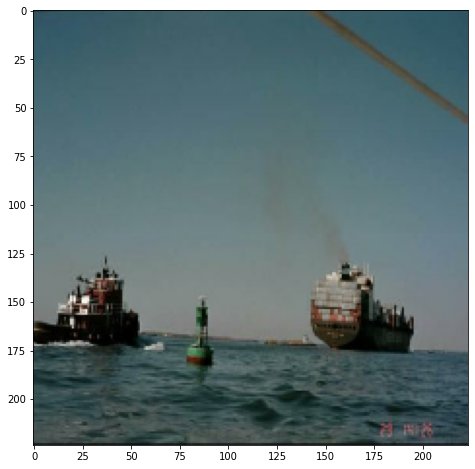

1/1 [==============================] - 0s 28ms/step
[[('n03095699', 'container_ship', 0.94510424), ('n03344393', 'fireboat', 0.012874535), ('n04606251', 'wreck', 0.010071996), ('n03240683', 'drilling_platform', 0.009773324), ('n03673027', 'liner', 0.0036565913)]]
1/1 [==============================] - 0s 48ms/step
[[('n03240683', 'drilling_platform', 0.9633363), ('n03126707', 'crane', 0.0031574848), ('n04606251', 'wreck', 0.0027430283), ('n03095699', 'container_ship', 0.001958542), ('n04347754', 'submarine', 0.0012365117)]]
1/1 [==============================] - 0s 48ms/step
[[('n03240683', 'drilling_platform', 0.6133459), ('n03095699', 'container_ship', 0.27614626), ('n03673027', 'liner', 0.04537055), ('n04606251', 'wreck', 0.013295912), ('n03947888', 'pirate', 0.010990065)]]
1/1 [==============================] - 0s 25ms/step
container_ship
1/1 [==============================] - 0s 29ms/step
0.66596246
1/1 [==============================] - 0s 28ms/step
drilling_platform
1/1 [=======

 40%|████      | 4/10 [01:42<02:34, 25.76s/it]

1/1 [==============================] - 0s 27ms/step


Only calculates 1-4 DARS


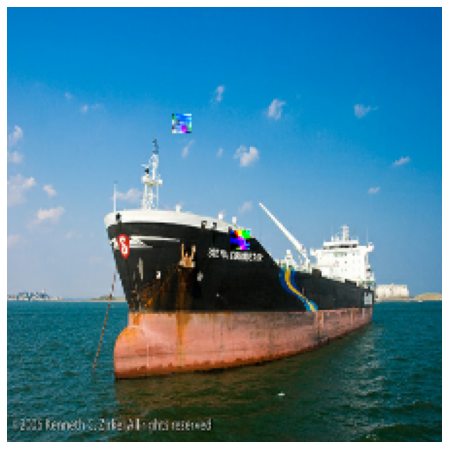

1/1 [==============================] - 0s 26ms/step
[[('n02687172', 'aircraft_carrier', 0.3102759), ('n03095699', 'container_ship', 0.11621983), ('n03344393', 'fireboat', 0.10253904), ('n03240683', 'drilling_platform', 0.08060138), ('n03673027', 'liner', 0.071860194)]]
1/1 [==============================] - 0s 47ms/step
[[('n03673027', 'liner', 0.80900276), ('n03216828', 'dock', 0.04139168), ('n02687172', 'aircraft_carrier', 0.02254076), ('n04273569', 'speedboat', 0.014723568), ('n03095699', 'container_ship', 0.01162901)]]
1/1 [==============================] - 0s 56ms/step
[[('n03095699', 'container_ship', 0.6064135), ('n03673027', 'liner', 0.28538004), ('n03216828', 'dock', 0.031573225), ('n04347754', 'submarine', 0.023556678), ('n04606251', 'wreck', 0.022381658)]]


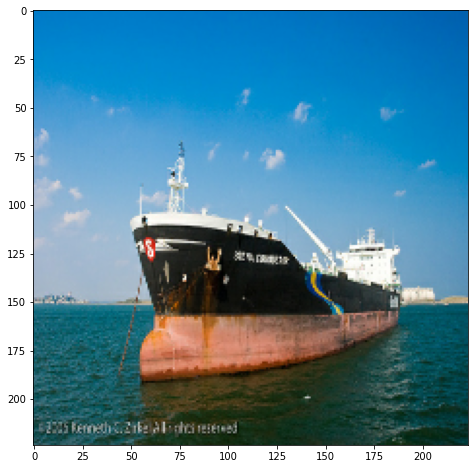

1/1 [==============================] - 0s 38ms/step
[[('n03095699', 'container_ship', 0.4567863), ('n04606251', 'wreck', 0.1699646), ('n03673027', 'liner', 0.15268254), ('n03240683', 'drilling_platform', 0.042450096), ('n03344393', 'fireboat', 0.03321149)]]
1/1 [==============================] - 0s 50ms/step
[[('n03673027', 'liner', 0.5125075), ('n03095699', 'container_ship', 0.21053386), ('n03216828', 'dock', 0.05656202), ('n04347754', 'submarine', 0.012149344), ('n04606251', 'wreck', 0.008425073)]]
1/1 [==============================] - 0s 48ms/step
[[('n03095699', 'container_ship', 0.8450342), ('n03673027', 'liner', 0.1057037), ('n04606251', 'wreck', 0.021284007), ('n03216828', 'dock', 0.013890507), ('n03240683', 'drilling_platform', 0.0032624581)]]
1/1 [==============================] - 0s 30ms/step
aircraft_carrier
1/1 [==============================] - 0s 26ms/step
0.3102759
1/1 [==============================] - 0s 30ms/step
container_ship
1/1 [==============================] - 

 50%|█████     | 5/10 [02:08<02:08, 25.78s/it]

1/1 [==============================] - 0s 32ms/step


Only calculates 1-4 DARS


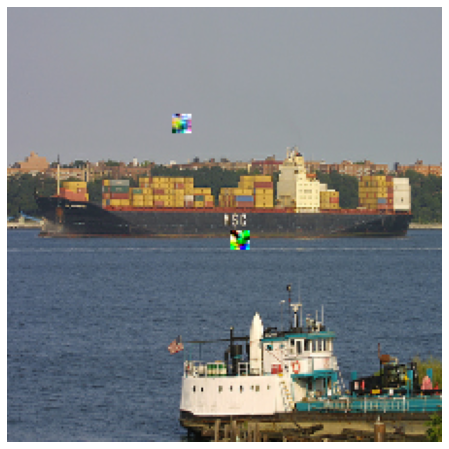

1/1 [==============================] - 0s 32ms/step
[[('n03095699', 'container_ship', 0.9963528), ('n03216828', 'dock', 0.0005120996), ('n03240683', 'drilling_platform', 0.00045367543), ('n03673027', 'liner', 0.00018643205), ('n09428293', 'seashore', 0.00016234614)]]
1/1 [==============================] - 0s 51ms/step
[[('n03095699', 'container_ship', 0.7727208), ('n03673027', 'liner', 0.032189194), ('n03933933', 'pier', 0.015034282), ('n03344393', 'fireboat', 0.0114819), ('n02894605', 'breakwater', 0.01116869)]]
1/1 [==============================] - 0s 43ms/step
[[('n03095699', 'container_ship', 0.99942255), ('n03673027', 'liner', 0.0003744974), ('n03216828', 'dock', 7.278543e-05), ('n03240683', 'drilling_platform', 3.0218434e-05), ('n02894605', 'breakwater', 1.7319457e-05)]]


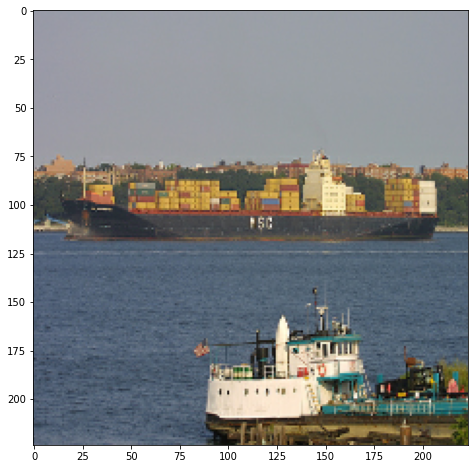

1/1 [==============================] - 0s 26ms/step
[[('n03095699', 'container_ship', 0.9782981), ('n03240683', 'drilling_platform', 0.0007378351), ('n03673027', 'liner', 0.0006680444), ('n03216828', 'dock', 0.0005437317), ('n03662601', 'lifeboat', 0.000511443)]]
1/1 [==============================] - 0s 51ms/step
[[('n03095699', 'container_ship', 0.9073195), ('n03673027', 'liner', 0.0031568464), ('n03216828', 'dock', 0.0027262813), ('n02276258', 'admiral', 0.0014682512), ('n04606251', 'wreck', 0.0010309494)]]
1/1 [==============================] - 0s 43ms/step
[[('n03095699', 'container_ship', 0.9999348), ('n03673027', 'liner', 4.2062078e-05), ('n03216828', 'dock', 8.969765e-06), ('n03240683', 'drilling_platform', 3.865818e-06), ('n09399592', 'promontory', 1.6154302e-06)]]
1/1 [==============================] - 0s 25ms/step
container_ship
1/1 [==============================] - 0s 27ms/step
0.9963528
1/1 [==============================] - 0s 27ms/step
dock
1/1 [========================

 60%|██████    | 6/10 [02:34<01:43, 25.79s/it]

1/1 [==============================] - 0s 27ms/step


Only calculates 1-4 DARS


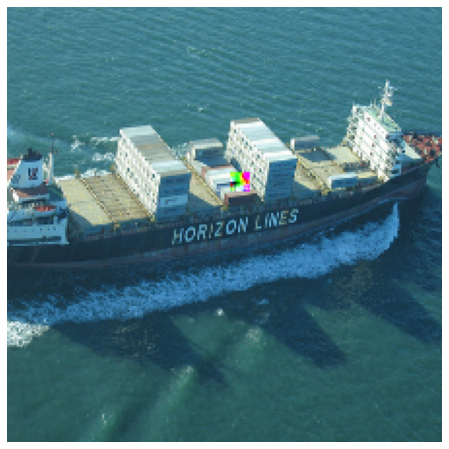

1/1 [==============================] - 0s 33ms/step
[[('n04273569', 'speedboat', 0.2840755), ('n02687172', 'aircraft_carrier', 0.15544179), ('n03095699', 'container_ship', 0.080387406), ('n03447447', 'gondola', 0.064863935), ('n04606251', 'wreck', 0.060301255)]]
1/1 [==============================] - 0s 51ms/step
[[('n03095699', 'container_ship', 0.78521895), ('n02687172', 'aircraft_carrier', 0.040612996), ('n04273569', 'speedboat', 0.037091434), ('n03344393', 'fireboat', 0.00978775), ('n03216828', 'dock', 0.009278759)]]
1/1 [==============================] - 0s 55ms/step
[[('n03095699', 'container_ship', 0.9429983), ('n03216828', 'dock', 0.031578306), ('n09332890', 'lakeside', 0.007765544), ('n02859443', 'boathouse', 0.004448795), ('n04606251', 'wreck', 0.0018859603)]]


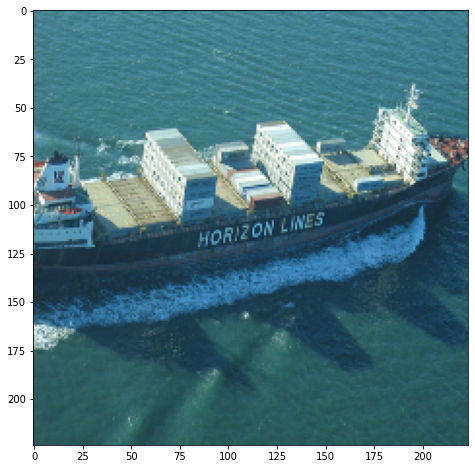

1/1 [==============================] - 0s 26ms/step
[[('n03095699', 'container_ship', 0.16412498), ('n02687172', 'aircraft_carrier', 0.142557), ('n03447447', 'gondola', 0.13100724), ('n04273569', 'speedboat', 0.11923334), ('n03216828', 'dock', 0.04782132)]]
1/1 [==============================] - 0s 49ms/step
[[('n03095699', 'container_ship', 0.92158645), ('n04273569', 'speedboat', 0.005408143), ('n02687172', 'aircraft_carrier', 0.0030365402), ('n03216828', 'dock', 0.0029466753), ('n04606251', 'wreck', 0.002254509)]]
1/1 [==============================] - 0s 42ms/step
[[('n03095699', 'container_ship', 0.90875417), ('n03216828', 'dock', 0.04617491), ('n09332890', 'lakeside', 0.020282762), ('n02859443', 'boathouse', 0.008013763), ('n02894605', 'breakwater', 0.0023403352)]]
1/1 [==============================] - 0s 25ms/step
speedboat
1/1 [==============================] - 0s 25ms/step
0.2840755
1/1 [==============================] - 0s 37ms/step
aircraft_carrier
1/1 [=====================

 70%|███████   | 7/10 [03:02<01:19, 26.51s/it]

1/1 [==============================] - 0s 27ms/step


Only calculates 1-4 DARS


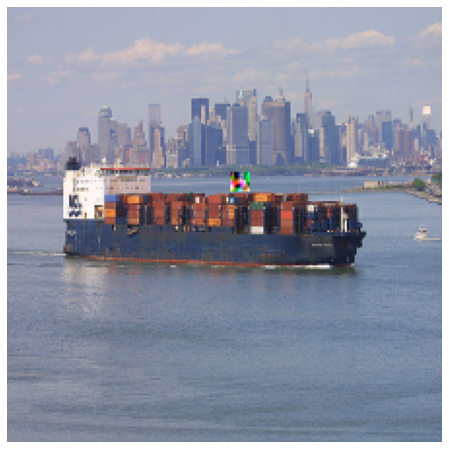

1/1 [==============================] - 0s 26ms/step
[[('n03095699', 'container_ship', 0.9310718), ('n03216828', 'dock', 0.010317841), ('n03662601', 'lifeboat', 0.006022974), ('n03240683', 'drilling_platform', 0.005170138), ('n03673027', 'liner', 0.0032827733)]]
1/1 [==============================] - 0s 53ms/step
[[('n03095699', 'container_ship', 0.8891211), ('n02276258', 'admiral', 0.0051944787), ('n04606251', 'wreck', 0.0027192251), ('n03673027', 'liner', 0.0015207834), ('n03216828', 'dock', 0.0010996858)]]
1/1 [==============================] - 0s 48ms/step
[[('n03095699', 'container_ship', 0.9999161), ('n03216828', 'dock', 3.9018712e-05), ('n03673027', 'liner', 1.4069313e-05), ('n03240683', 'drilling_platform', 7.3329584e-06), ('n04606251', 'wreck', 4.2127995e-06)]]


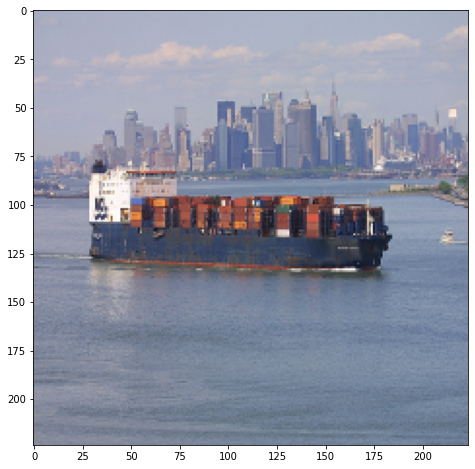

1/1 [==============================] - 0s 28ms/step
[[('n03095699', 'container_ship', 0.9499949), ('n03216828', 'dock', 0.009588506), ('n03673027', 'liner', 0.00330172), ('n03240683', 'drilling_platform', 0.0026604063), ('n03933933', 'pier', 0.0025635664)]]
1/1 [==============================] - 0s 52ms/step
[[('n03095699', 'container_ship', 0.89696187), ('n02276258', 'admiral', 0.0039836424), ('n04606251', 'wreck', 0.001868453), ('n03673027', 'liner', 0.0018345836), ('n03216828', 'dock', 0.00135046)]]
1/1 [==============================] - 0s 45ms/step
[[('n03095699', 'container_ship', 0.9997851), ('n03216828', 'dock', 9.6382304e-05), ('n03673027', 'liner', 4.2549003e-05), ('n04606251', 'wreck', 1.7425413e-05), ('n03933933', 'pier', 1.6690406e-05)]]
1/1 [==============================] - 0s 29ms/step
container_ship
1/1 [==============================] - 0s 26ms/step
0.9310718
1/1 [==============================] - 0s 29ms/step
dock
1/1 [==============================] - 0s 29ms/step
0

 80%|████████  | 8/10 [03:28<00:52, 26.46s/it]

1/1 [==============================] - 0s 27ms/step


Only calculates 1-4 DARS


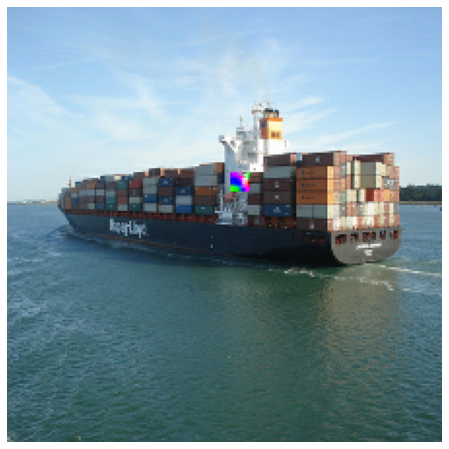

1/1 [==============================] - 0s 43ms/step
[[('n03095699', 'container_ship', 0.8778), ('n03673027', 'liner', 0.0024390018), ('n03662601', 'lifeboat', 0.0015749527), ('n04606251', 'wreck', 0.0015218292), ('n03216828', 'dock', 0.0009247021)]]
1/1 [==============================] - 0s 52ms/step
[[('n03095699', 'container_ship', 0.92378145), ('n02276258', 'admiral', 0.0021599226), ('n03216828', 'dock', 0.00088286184), ('n03673027', 'liner', 0.000633106), ('n04606251', 'wreck', 0.0004906194)]]
1/1 [==============================] - 0s 57ms/step
[[('n03095699', 'container_ship', 1.0), ('n03673027', 'liner', 1.7843514e-09), ('n03216828', 'dock', 3.2880068e-10), ('n02509815', 'lesser_panda', 2.1097898e-10), ('n03947888', 'pirate', 1.9913805e-10)]]


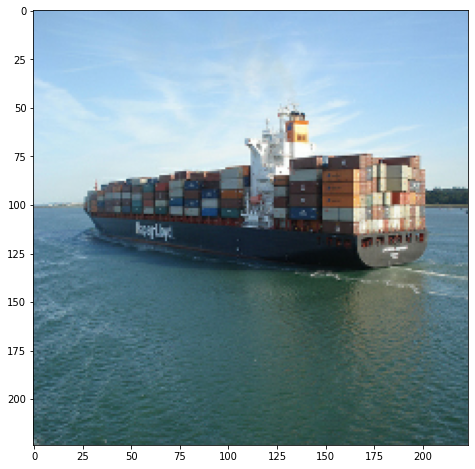

1/1 [==============================] - 0s 42ms/step
[[('n03095699', 'container_ship', 0.8368208), ('n03673027', 'liner', 0.0037700343), ('n03662601', 'lifeboat', 0.0023094907), ('n04606251', 'wreck', 0.0022471277), ('n03216828', 'dock', 0.0010575803)]]
1/1 [==============================] - 0s 56ms/step
[[('n03095699', 'container_ship', 0.9075345), ('n02276258', 'admiral', 0.003104096), ('n02281787', 'lycaenid', 0.0014696618), ('n03216828', 'dock', 0.001322569), ('n03673027', 'liner', 0.0007130823)]]
1/1 [==============================] - 0s 47ms/step
[[('n03095699', 'container_ship', 1.0), ('n03673027', 'liner', 6.741111e-10), ('n02509815', 'lesser_panda', 1.2547437e-10), ('n03240683', 'drilling_platform', 6.466386e-11), ('n03216828', 'dock', 6.289782e-11)]]
1/1 [==============================] - 0s 25ms/step
container_ship
1/1 [==============================] - 0s 25ms/step
0.8778
1/1 [==============================] - 0s 28ms/step
liner
1/1 [==============================] - 0s 24ms

 90%|█████████ | 9/10 [03:54<00:26, 26.38s/it]

1/1 [==============================] - 0s 28ms/step


Only calculates 1-4 DARS


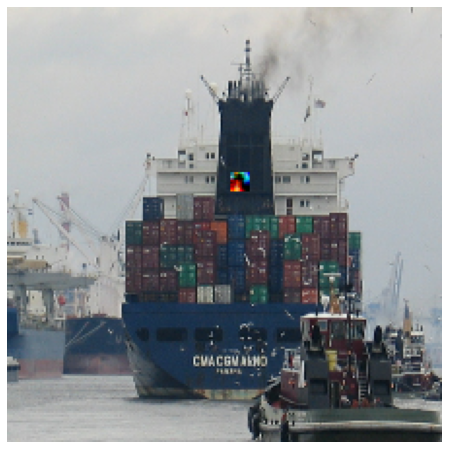

1/1 [==============================] - 0s 46ms/step
[[('n03095699', 'container_ship', 0.895641), ('n03240683', 'drilling_platform', 0.005999159), ('n02687172', 'aircraft_carrier', 0.0047527566), ('n03344393', 'fireboat', 0.0043438), ('n04347754', 'submarine', 0.0033651718)]]
1/1 [==============================] - 0s 50ms/step
[[('n03095699', 'container_ship', 0.913492), ('n03216828', 'dock', 0.0030594936), ('n02276258', 'admiral', 0.0017093568), ('n03673027', 'liner', 0.0012770828), ('n02281787', 'lycaenid', 0.0008939122)]]
1/1 [==============================] - 0s 61ms/step
[[('n03095699', 'container_ship', 0.9999993), ('n03216828', 'dock', 5.147864e-07), ('n03673027', 'liner', 2.0105122e-07), ('n03947888', 'pirate', 8.6211225e-09), ('n03344393', 'fireboat', 6.869688e-09)]]


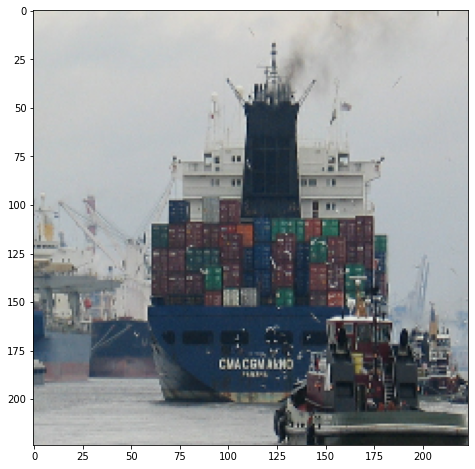

1/1 [==============================] - 0s 30ms/step
[[('n03095699', 'container_ship', 0.9146652), ('n03344393', 'fireboat', 0.007662642), ('n02687172', 'aircraft_carrier', 0.005135867), ('n03240683', 'drilling_platform', 0.0044340068), ('n03216828', 'dock', 0.003215988)]]
1/1 [==============================] - 0s 53ms/step
[[('n03095699', 'container_ship', 0.8899288), ('n03216828', 'dock', 0.002993511), ('n02276258', 'admiral', 0.0027163874), ('n02281787', 'lycaenid', 0.0018605008), ('n03673027', 'liner', 0.0014001953)]]
1/1 [==============================] - 0s 48ms/step
[[('n03095699', 'container_ship', 0.99999964), ('n03216828', 'dock', 2.1040759e-07), ('n03673027', 'liner', 1.0218571e-07), ('n03344393', 'fireboat', 4.5439323e-09), ('n03240683', 'drilling_platform', 4.3427453e-09)]]
1/1 [==============================] - 0s 29ms/step
container_ship
1/1 [==============================] - 0s 25ms/step
0.895641
1/1 [==============================] - 0s 24ms/step
drilling_platform
1/1 [

  0%|          | 0/10 [00:00<?, ?it/s]

1/1 [==============================] - 0s 57ms/step


Only calculates 1-4 DARS


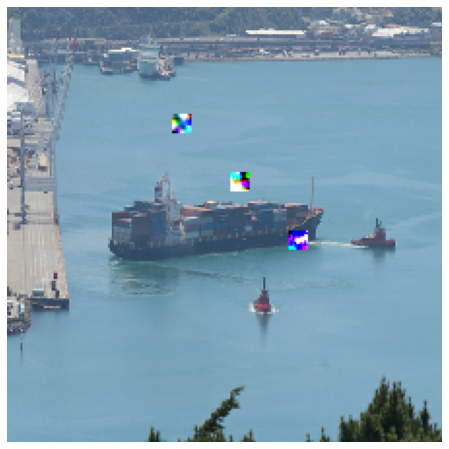

1/1 [==============================] - 0s 38ms/step
[[('n03216828', 'dock', 0.15345581), ('n03095699', 'container_ship', 0.14624608), ('n03947888', 'pirate', 0.13126735), ('n04606251', 'wreck', 0.06332694), ('n02894605', 'breakwater', 0.05204077)]]
1/1 [==============================] - 0s 48ms/step
[[('n03673027', 'liner', 0.24106044), ('n02687172', 'aircraft_carrier', 0.16176826), ('n02692877', 'airship', 0.070751026), ('n02690373', 'airliner', 0.053630814), ('n04347754', 'submarine', 0.04315476)]]
1/1 [==============================] - 0s 50ms/step
[[('n03095699', 'container_ship', 0.76290554), ('n03673027', 'liner', 0.057186), ('n03216828', 'dock', 0.037245438), ('n03240683', 'drilling_platform', 0.03587332), ('n04347754', 'submarine', 0.013723449)]]


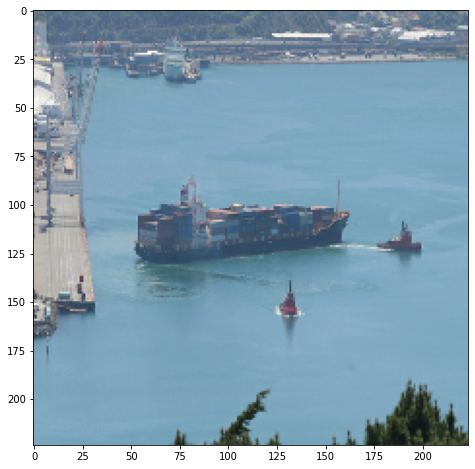

1/1 [==============================] - 0s 43ms/step
[[('n03095699', 'container_ship', 0.78223735), ('n03216828', 'dock', 0.048542347), ('n03673027', 'liner', 0.024140745), ('n04606251', 'wreck', 0.023428937), ('n03662601', 'lifeboat', 0.020365655)]]
1/1 [==============================] - 0s 52ms/step
[[('n03095699', 'container_ship', 0.91552174), ('n03216828', 'dock', 0.011323566), ('n03240683', 'drilling_platform', 0.004474279), ('n03673027', 'liner', 0.0033326943), ('n03126707', 'crane', 0.0027345712)]]
1/1 [==============================] - 0s 48ms/step
[[('n03095699', 'container_ship', 0.8569311), ('n03240683', 'drilling_platform', 0.06213683), ('n03673027', 'liner', 0.027860053), ('n03216828', 'dock', 0.010862873), ('n03947888', 'pirate', 0.010721225)]]
1/1 [==============================] - 0s 25ms/step
dock
1/1 [==============================] - 0s 24ms/step
0.15345581
1/1 [==============================] - 0s 26ms/step
container_ship
1/1 [==============================] - 0s 24

 10%|█         | 1/10 [00:29<04:24, 29.41s/it]

1/1 [==============================] - 0s 30ms/step


Only calculates 1-4 DARS


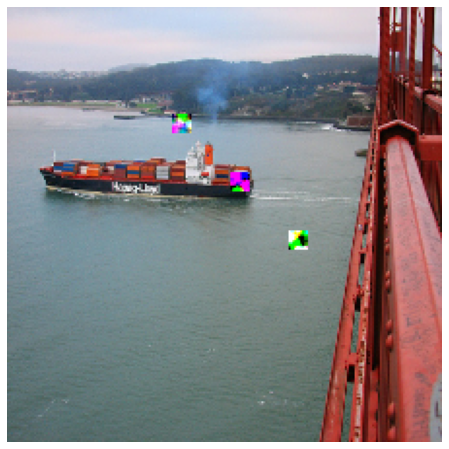

1/1 [==============================] - 0s 26ms/step
[[('n03095699', 'container_ship', 0.72678417), ('n03344393', 'fireboat', 0.14680189), ('n03662601', 'lifeboat', 0.019852022), ('n03933933', 'pier', 0.019036451), ('n09332890', 'lakeside', 0.01364347)]]
1/1 [==============================] - 0s 52ms/step
[[('n03216828', 'dock', 0.4293839), ('n02859443', 'boathouse', 0.11909939), ('n03095699', 'container_ship', 0.086615674), ('n03933933', 'pier', 0.042661224), ('n09332890', 'lakeside', 0.04162767)]]
1/1 [==============================] - 0s 48ms/step
[[('n03095699', 'container_ship', 0.9954745), ('n03933933', 'pier', 0.001758057), ('n03662601', 'lifeboat', 0.0007282251), ('n03216828', 'dock', 0.00048762577), ('n02894605', 'breakwater', 0.0004189545)]]


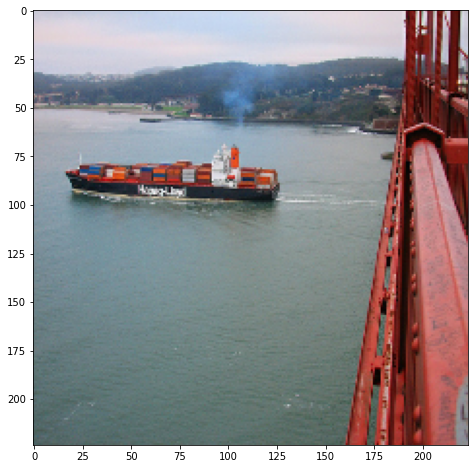

1/1 [==============================] - 0s 26ms/step
[[('n03095699', 'container_ship', 0.6712358), ('n03344393', 'fireboat', 0.17462455), ('n03662601', 'lifeboat', 0.04016742), ('n09332890', 'lakeside', 0.013037995), ('n03933933', 'pier', 0.011188816)]]
1/1 [==============================] - 0s 50ms/step
[[('n03095699', 'container_ship', 0.8478747), ('n03662601', 'lifeboat', 0.021614032), ('n03216828', 'dock', 0.011861247), ('n03344393', 'fireboat', 0.0062176026), ('n03240683', 'drilling_platform', 0.0055907853)]]
1/1 [==============================] - 0s 43ms/step
[[('n03095699', 'container_ship', 0.9955205), ('n03662601', 'lifeboat', 0.0027789776), ('n03344393', 'fireboat', 0.00084470224), ('n03216828', 'dock', 0.00018764369), ('n03933933', 'pier', 0.00012920125)]]
1/1 [==============================] - 0s 26ms/step
container_ship
1/1 [==============================] - 0s 32ms/step
0.72678417
1/1 [==============================] - 0s 27ms/step
fireboat
1/1 [===========================

 20%|██        | 2/10 [00:57<03:51, 28.88s/it]

1/1 [==============================] - 0s 26ms/step


Only calculates 1-4 DARS


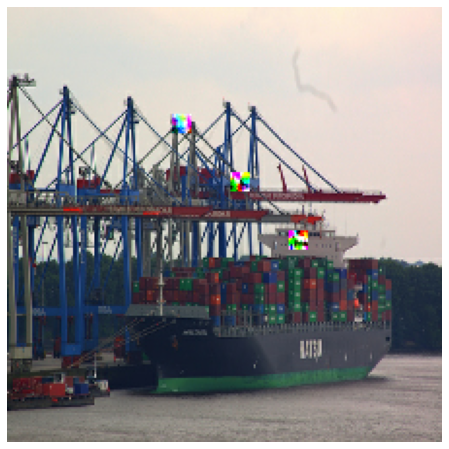

1/1 [==============================] - 0s 36ms/step
[[('n03095699', 'container_ship', 0.9544329), ('n03240683', 'drilling_platform', 0.016275423), ('n03216828', 'dock', 0.00746181), ('n03947888', 'pirate', 0.0015787074), ('n03126707', 'crane', 0.00069886254)]]
1/1 [==============================] - 0s 49ms/step
[[('n06874185', 'traffic_light', 0.63948345), ('n03095699', 'container_ship', 0.064888924), ('n03933933', 'pier', 0.05611053), ('n04335435', 'streetcar', 0.01882702), ('n04366367', 'suspension_bridge', 0.010170513)]]
1/1 [==============================] - 0s 78ms/step
[[('n03095699', 'container_ship', 0.9997564), ('n03933933', 'pier', 0.00010832749), ('n03126707', 'crane', 7.6393946e-05), ('n03216828', 'dock', 1.8973984e-05), ('n03673027', 'liner', 1.4741625e-05)]]


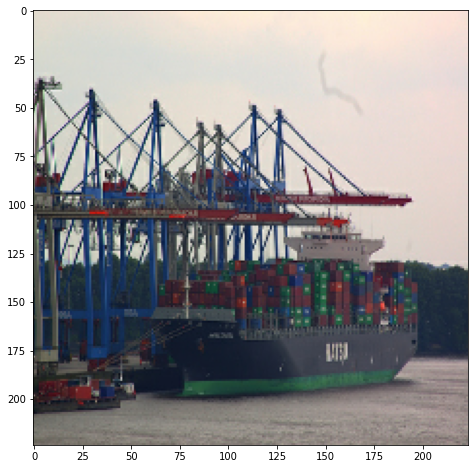

1/1 [==============================] - 0s 26ms/step
[[('n03095699', 'container_ship', 0.9612319), ('n03216828', 'dock', 0.004091908), ('n03240683', 'drilling_platform', 0.0039012542), ('n03126707', 'crane', 0.0005364778), ('n03947888', 'pirate', 0.00051035784)]]
1/1 [==============================] - 0s 50ms/step
[[('n03095699', 'container_ship', 0.8649383), ('n03216828', 'dock', 0.007409305), ('n03673027', 'liner', 0.0024012423), ('n02276258', 'admiral', 0.0014606745), ('n03240683', 'drilling_platform', 0.0013118742)]]
1/1 [==============================] - 0s 52ms/step
[[('n03095699', 'container_ship', 0.9999968), ('n03126707', 'crane', 1.152884e-06), ('n03673027', 'liner', 6.476234e-07), ('n03933933', 'pier', 5.6155795e-07), ('n03216828', 'dock', 2.6035173e-07)]]
1/1 [==============================] - 0s 26ms/step
container_ship
1/1 [==============================] - 0s 26ms/step
0.9544329
1/1 [==============================] - 0s 44ms/step
drilling_platform
1/1 [===================

 30%|███       | 3/10 [01:26<03:22, 28.94s/it]

1/1 [==============================] - 0s 29ms/step


Only calculates 1-4 DARS


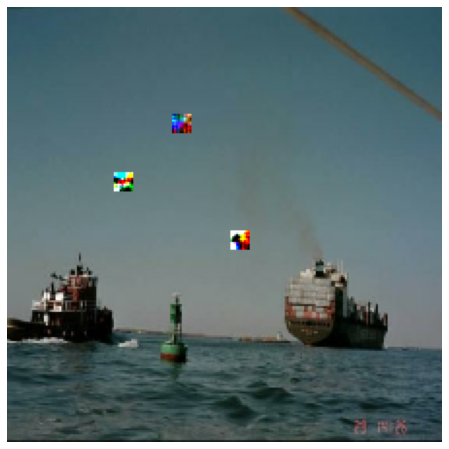

1/1 [==============================] - 0s 34ms/step
[[('n03095699', 'container_ship', 0.55776066), ('n02782093', 'balloon', 0.073084354), ('n03240683', 'drilling_platform', 0.061033987), ('n03888257', 'parachute', 0.025181862), ('n06874185', 'traffic_light', 0.023631344)]]
1/1 [==============================] - 0s 56ms/step
[[('n02782093', 'balloon', 0.40123233), ('n06874185', 'traffic_light', 0.2950238), ('n03888257', 'parachute', 0.043450925), ('n04540053', 'volleyball', 0.0075150286), ('n03942813', 'ping-pong_ball', 0.0049637924)]]
1/1 [==============================] - 0s 49ms/step
[[('n03095699', 'container_ship', 0.36511916), ('n03240683', 'drilling_platform', 0.3320696), ('n03673027', 'liner', 0.19128492), ('n04606251', 'wreck', 0.01755022), ('n09428293', 'seashore', 0.0146136675)]]


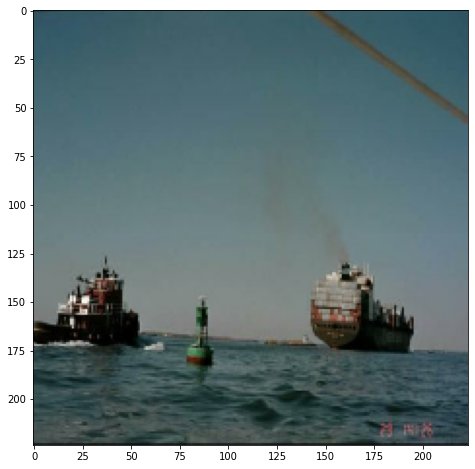

1/1 [==============================] - 0s 27ms/step
[[('n03095699', 'container_ship', 0.94510424), ('n03344393', 'fireboat', 0.012874535), ('n04606251', 'wreck', 0.010071996), ('n03240683', 'drilling_platform', 0.009773324), ('n03673027', 'liner', 0.0036565913)]]
1/1 [==============================] - 0s 59ms/step
[[('n03240683', 'drilling_platform', 0.9633363), ('n03126707', 'crane', 0.0031574848), ('n04606251', 'wreck', 0.0027430283), ('n03095699', 'container_ship', 0.001958542), ('n04347754', 'submarine', 0.0012365117)]]
1/1 [==============================] - 0s 45ms/step
[[('n03240683', 'drilling_platform', 0.6133459), ('n03095699', 'container_ship', 0.27614626), ('n03673027', 'liner', 0.04537055), ('n04606251', 'wreck', 0.013295912), ('n03947888', 'pirate', 0.010990065)]]
1/1 [==============================] - 0s 24ms/step
container_ship
1/1 [==============================] - 0s 31ms/step
0.55776066
1/1 [==============================] - 0s 42ms/step
balloon
1/1 [=================

 40%|████      | 4/10 [01:56<02:54, 29.14s/it]

1/1 [==============================] - 0s 31ms/step


Only calculates 1-4 DARS


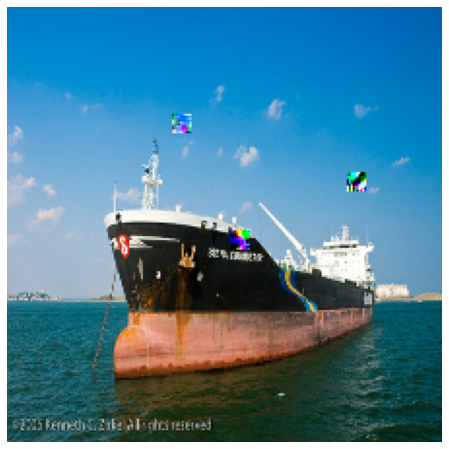

1/1 [==============================] - 0s 31ms/step
[[('n02687172', 'aircraft_carrier', 0.31624633), ('n03344393', 'fireboat', 0.10967128), ('n03095699', 'container_ship', 0.109507255), ('n04606251', 'wreck', 0.0710512), ('n03240683', 'drilling_platform', 0.06562401)]]
1/1 [==============================] - 0s 55ms/step
[[('n03673027', 'liner', 0.6291769), ('n03216828', 'dock', 0.06363968), ('n02687172', 'aircraft_carrier', 0.03618267), ('n04273569', 'speedboat', 0.028981341), ('n03095699', 'container_ship', 0.019385105)]]
1/1 [==============================] - 0s 64ms/step
[[('n03095699', 'container_ship', 0.3880334), ('n03673027', 'liner', 0.3500822), ('n03216828', 'dock', 0.096711926), ('n04606251', 'wreck', 0.05113497), ('n04347754', 'submarine', 0.039106015)]]


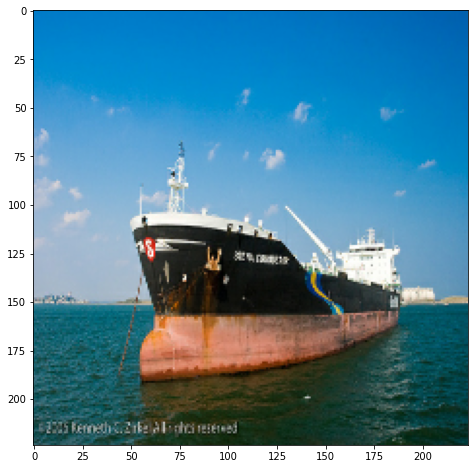

1/1 [==============================] - 0s 39ms/step
[[('n03095699', 'container_ship', 0.4567863), ('n04606251', 'wreck', 0.1699646), ('n03673027', 'liner', 0.15268254), ('n03240683', 'drilling_platform', 0.042450096), ('n03344393', 'fireboat', 0.03321149)]]
1/1 [==============================] - 0s 51ms/step
[[('n03673027', 'liner', 0.5125075), ('n03095699', 'container_ship', 0.21053386), ('n03216828', 'dock', 0.05656202), ('n04347754', 'submarine', 0.012149344), ('n04606251', 'wreck', 0.008425073)]]
1/1 [==============================] - 0s 54ms/step
[[('n03095699', 'container_ship', 0.8450342), ('n03673027', 'liner', 0.1057037), ('n04606251', 'wreck', 0.021284007), ('n03216828', 'dock', 0.013890507), ('n03240683', 'drilling_platform', 0.0032624581)]]
1/1 [==============================] - 0s 30ms/step
aircraft_carrier
1/1 [==============================] - 0s 24ms/step
0.31624633
1/1 [==============================] - 0s 41ms/step
fireboat
1/1 [==============================] - 0s 26

 50%|█████     | 5/10 [02:26<02:26, 29.35s/it]

1/1 [==============================] - 0s 25ms/step


Only calculates 1-4 DARS


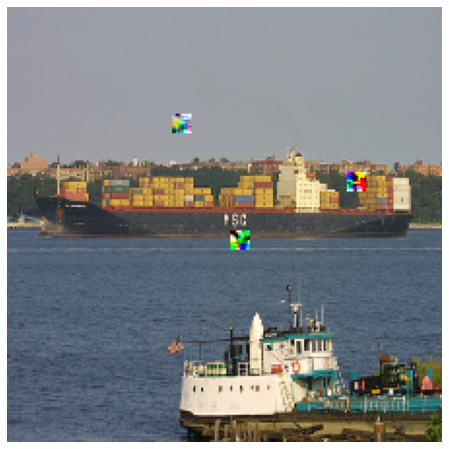

1/1 [==============================] - 0s 38ms/step
[[('n03095699', 'container_ship', 0.9939698), ('n03216828', 'dock', 0.0012845803), ('n03240683', 'drilling_platform', 0.0008914472), ('n03673027', 'liner', 0.00024282279), ('n03933933', 'pier', 0.00018096241)]]
1/1 [==============================] - 0s 50ms/step
[[('n03095699', 'container_ship', 0.26239842), ('n06874185', 'traffic_light', 0.10304938), ('n03673027', 'liner', 0.07554462), ('n03933933', 'pier', 0.04112187), ('n02692877', 'airship', 0.02824777)]]
1/1 [==============================] - 0s 43ms/step
[[('n03095699', 'container_ship', 0.9987143), ('n03673027', 'liner', 0.0008611725), ('n03216828', 'dock', 0.00017072687), ('n03240683', 'drilling_platform', 4.354687e-05), ('n02894605', 'breakwater', 3.940801e-05)]]


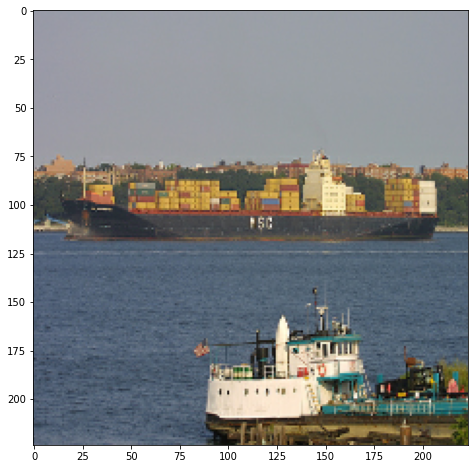

1/1 [==============================] - 0s 31ms/step
[[('n03095699', 'container_ship', 0.9782981), ('n03240683', 'drilling_platform', 0.0007378351), ('n03673027', 'liner', 0.0006680444), ('n03216828', 'dock', 0.0005437317), ('n03662601', 'lifeboat', 0.000511443)]]
1/1 [==============================] - 0s 49ms/step
[[('n03095699', 'container_ship', 0.9073195), ('n03673027', 'liner', 0.0031568464), ('n03216828', 'dock', 0.0027262813), ('n02276258', 'admiral', 0.0014682512), ('n04606251', 'wreck', 0.0010309494)]]
1/1 [==============================] - 0s 49ms/step
[[('n03095699', 'container_ship', 0.9999348), ('n03673027', 'liner', 4.2062078e-05), ('n03216828', 'dock', 8.969765e-06), ('n03240683', 'drilling_platform', 3.865818e-06), ('n09399592', 'promontory', 1.6154302e-06)]]
1/1 [==============================] - 0s 30ms/step
container_ship
1/1 [==============================] - 0s 26ms/step
0.9939698
1/1 [==============================] - 0s 25ms/step
dock
1/1 [========================

 60%|██████    | 6/10 [02:54<01:55, 28.96s/it]

1/1 [==============================] - 0s 25ms/step


 60%|██████    | 6/10 [03:17<02:11, 32.96s/it]


error: ignored

In [ ]:
size = [10,10,10,14,14,14,14] #Need to check it goes through every combination of size and number. Also check that number = 1,2,3,4 (it's only 2 or 3)
number = 1
for i,size in enumerate(size):
  #All this stuff gets changed for each image
  real_label_index = 510 #Container Ship
  Obj = 'Ship'
  #im1_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/imagenet_racer.JPEG")

  files = os.listdir("/content/gdrive/MyDrive/Data/DAR_data/Imagenet_ship")

  model = mobilenetv2
  x_value = []
  y_value = []
  size_val = []
  num_val = []
  conf_results = []
  imgclassmobilenetpet = []
  predsmobilenetpet = []
  imgclassmobilenetpet_top2 = []
  predsmobilenetpet_top2 = []
  imgclassmobilenetpet_top3 = []
  predsmobilenetpet_top3 = []
  imgclassnasnetpet = []
  predsnasnetpet = []
  imgclassnasnetpet_top2 = []
  predsnasnetpet_top2 = []
  imgclassnasnetpet_top3 = []
  predsnasnetpet_top3 = []
  imgclassdensenetpet = []
  predsdensenetpet = []  
  imgclassdensenetpet_top2 = []
  predsdensenetpet_top2 = []
  imgclassdensenetpet_top3 = []
  predsdensenetpet_top3 = []
  imgclassmobilenet = []
  predsmobilenet = []
  imgclassmobilenet_top2 = []
  predsmobilenet_top2 = []
  imgclassmobilenet_top3 = []
  predsmobilenet_top3 = []
  imgclassnasnet = []
  predsnasnet = []
  imgclassnasnet_top2 = []
  predsnasnet_top2 = []
  imgclassnasnet_top3 = []
  predsnasnet_top3 = []
  imgclassdensenet = []
  predsdensenet = []
  imgclassdensenet_top2 = []
  predsdensenet_top2 = []
  imgclassdensenet_top3 = []
  predsdensenet_top3 = []

# Figure out why locations aren't updating for some pictures, and why other models have same result
  for file in tqdm(files):
    #image path
    im1_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Imagenet_ship/{file}")
    im1 = tf.image.decode_image(im1_raw)
    image = preprocess(im1)

    adv_dar(image)
    include = [1]*len(x_value)
    create_adv_dars_auto(size,number)

    #Save results
    g = gen_mod_results() #Need to 'clean' results csv
    g.to_csv('/content/gdrive/MyDrive/Data/DAR_data/Results/cleanresults.csv', mode='a', sep='\t')
    d = gen_mod_results_pet()
    d.to_csv('/content/gdrive/MyDrive/Data/DAR_data/Results/petresults.csv', mode='a', sep='\t')
  
  if number <4:
    number = number+1
  else:
    number = 1

# Bagel

n07693725

In [ ]:
size = [10,10,10,10,14,14,14,14] #Need to check it goes through every combination of size and number. Also check that number = 1,2,3,4 (it's only 2 or 3)
number = 1
for i,size in enumerate(size):
  #All this stuff gets changed for each image
  real_label_index = 931 #Bagel
  Obj = 'Bagel'
  #im1_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/imagenet_racer.JPEG")

  files = os.listdir("/content/gdrive/MyDrive/Data/DAR_data/Imagenet_bagel")

  model = mobilenetv2
  x_value = []
  y_value = []
  size_val = []
  num_val = []
  conf_results = []
  imgclassmobilenetpet = []
  predsmobilenetpet = []
  imgclassmobilenetpet_top2 = []
  predsmobilenetpet_top2 = []
  imgclassmobilenetpet_top3 = []
  predsmobilenetpet_top3 = []
  imgclassnasnetpet = []
  predsnasnetpet = []
  imgclassnasnetpet_top2 = []
  predsnasnetpet_top2 = []
  imgclassnasnetpet_top3 = []
  predsnasnetpet_top3 = []
  imgclassdensenetpet = []
  predsdensenetpet = []  
  imgclassdensenetpet_top2 = []
  predsdensenetpet_top2 = []
  imgclassdensenetpet_top3 = []
  predsdensenetpet_top3 = []
  imgclassmobilenet = []
  predsmobilenet = []
  imgclassmobilenet_top2 = []
  predsmobilenet_top2 = []
  imgclassmobilenet_top3 = []
  predsmobilenet_top3 = []
  imgclassnasnet = []
  predsnasnet = []
  imgclassnasnet_top2 = []
  predsnasnet_top2 = []
  imgclassnasnet_top3 = []
  predsnasnet_top3 = []
  imgclassdensenet = []
  predsdensenet = []
  imgclassdensenet_top2 = []
  predsdensenet_top2 = []
  imgclassdensenet_top3 = []
  predsdensenet_top3 = []

# Figure out why locations aren't updating for some pictures, and why other models have same result
  for file in tqdm(files):
    #image path
    im1_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Imagenet_bagel/{file}")
    im1 = tf.image.decode_image(im1_raw)
    image = preprocess(im1)

    adv_dar(image)
    include = [1]*len(x_value)
    create_adv_dars_auto(size,number)

    #Save results
    g = gen_mod_results() #Need to 'clean' results csv
    g.to_csv('/content/gdrive/MyDrive/Data/DAR_data/Results/cleanresults.csv', mode='a', sep='\t')
    d = gen_mod_results_pet()
    d.to_csv('/content/gdrive/MyDrive/Data/DAR_data/Results/petresults.csv', mode='a', sep='\t')
  
  if number <4:
    number = number+1
  else:
    number = 1

# Echidna

n01872401

In [ ]:
size = [2,2,2,2,6,6,6,6,10,10,10,10,14,14,14,14] #Need to check it goes through every combination of size and number. Also check that number = 1,2,3,4 (it's only 2 or 3)
number = 1
for i,size in enumerate(size):
  #All this stuff gets changed for each image
  real_label_index = 102 #Echidna
  Obj = 'Echidna'
  #im1_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/imagenet_racer.JPEG")

  files = os.listdir("/content/gdrive/MyDrive/Data/DAR_data/Imagenet_echidna")

  model = mobilenetv2
  x_value = []
  y_value = []
  size_val = []
  num_val = []
  conf_results = []
  imgclassmobilenetpet = []
  predsmobilenetpet = []
  imgclassmobilenetpet_top2 = []
  predsmobilenetpet_top2 = []
  imgclassmobilenetpet_top3 = []
  predsmobilenetpet_top3 = []
  imgclassnasnetpet = []
  predsnasnetpet = []
  imgclassnasnetpet_top2 = []
  predsnasnetpet_top2 = []
  imgclassnasnetpet_top3 = []
  predsnasnetpet_top3 = []
  imgclassdensenetpet = []
  predsdensenetpet = []  
  imgclassdensenetpet_top2 = []
  predsdensenetpet_top2 = []
  imgclassdensenetpet_top3 = []
  predsdensenetpet_top3 = []
  imgclassmobilenet = []
  predsmobilenet = []
  imgclassmobilenet_top2 = []
  predsmobilenet_top2 = []
  imgclassmobilenet_top3 = []
  predsmobilenet_top3 = []
  imgclassnasnet = []
  predsnasnet = []
  imgclassnasnet_top2 = []
  predsnasnet_top2 = []
  imgclassnasnet_top3 = []
  predsnasnet_top3 = []
  imgclassdensenet = []
  predsdensenet = []
  imgclassdensenet_top2 = []
  predsdensenet_top2 = []
  imgclassdensenet_top3 = []
  predsdensenet_top3 = []

# Figure out why locations aren't updating for some pictures, and why other models have same result
  for file in tqdm(files):
    #image path
    im1_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Imagenet_echidna/{file}")
    im1 = tf.image.decode_image(im1_raw)
    image = preprocess(im1)

    adv_dar(image)
    include = [1]*len(x_value)
    create_adv_dars_auto(size,number)

    #Save results
    g = gen_mod_results() #Need to 'clean' results csv
    g.to_csv('/content/gdrive/MyDrive/Data/DAR_data/Results/cleanresults.csv', mode='a', sep='\t')
    d = gen_mod_results_pet()
    d.to_csv('/content/gdrive/MyDrive/Data/DAR_data/Results/petresults.csv', mode='a', sep='\t')
  
  if number <4:
    number = number+1
  else:
    number = 1

# Testing hyperparameters

In [ ]:
im1_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/imagenet_racer.JPEG")
im1 = tf.image.decode_image(im1_raw)
image = preprocess(im1)

  #Save results for clean images
  #Mobilenet
image_probs_mobilenet = mobilenetv2.predict(image)
_, image_class, class_confidence = get_imagenet_label(image_probs_mobilenet)
print(image_class, class_confidence)

  #Nasnet
image_probs_nasnet = nasnet.predict(image)
_, image_class, class_confidence = get_imagenet_label(image_probs_nasnet)
print(image_class, class_confidence)

  #Densenet
image_probs_densenet = densenet.predict(image)
_, image_class, class_confidence = get_imagenet_label(image_probs_densenet)
print(image_class, class_confidence)



In [ ]:
im1_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/imagenet_ship.JPEG")
im1 = tf.image.decode_image(im1_raw)
image = preprocess(im1)

  #Save results for clean images
  #Mobilenet
image_probs_mobilenet = mobilenetv2.predict(image)
_, image_class, class_confidence = get_imagenet_label(image_probs_mobilenet)
print(image_class, class_confidence)

  #Nasnet
image_probs_nasnet = nasnet.predict(image)
_, image_class, class_confidence = get_imagenet_label(image_probs_nasnet)
print(image_class, class_confidence)

  #Densenet
image_probs_densenet = densenet.predict(image)
_, image_class, class_confidence = get_imagenet_label(image_probs_densenet)
print(image_class, class_confidence)

# Generating images to compare with WI

1/1 [==============================] - 0s 17ms/step
60
60
150
120
30
180
90
150


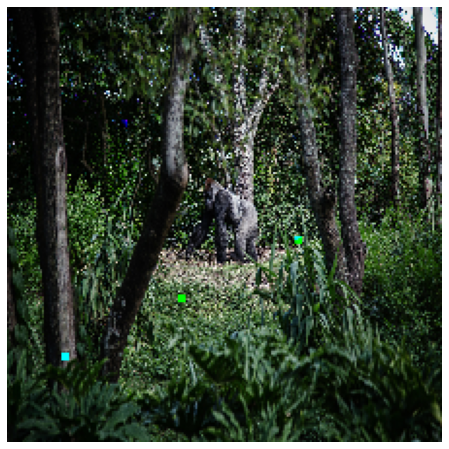

1/1 [==============================] - 0s 25ms/step
[[('n02361337', 'marmot', 0.28905585), ('n02363005', 'beaver', 0.14299768), ('n01877812', 'wallaby', 0.054670658), ('n02497673', 'Madagascar_cat', 0.043510687), ('n02444819', 'otter', 0.040304318)]]
1/1 [==============================] - 0s 45ms/step
[[('n06874185', 'traffic_light', 0.6333421), ('n09229709', 'bubble', 0.07165668), ('n03388043', 'fountain', 0.011901025), ('n04286575', 'spotlight', 0.007091864), ('n06794110', 'street_sign', 0.006684604)]]
1/1 [==============================] - 0s 32ms/step
[[('n01806143', 'peacock', 0.5769495), ('n06874185', 'traffic_light', 0.31389868), ('n03134739', 'croquet_ball', 0.09154743), ('n01537544', 'indigo_bunting', 0.005846178), ('n03733281', 'maze', 0.0019313317)]]


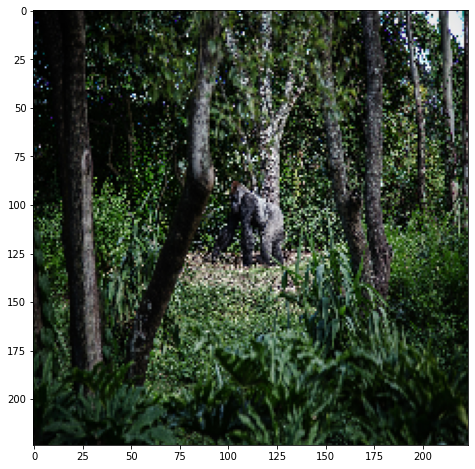

1/1 [==============================] - 0s 29ms/step
[[('n02361337', 'marmot', 0.19759132), ('n01877812', 'wallaby', 0.08899991), ('n02497673', 'Madagascar_cat', 0.08774654), ('n02363005', 'beaver', 0.068605274), ('n02444819', 'otter', 0.061841197)]]
1/1 [==============================] - 0s 42ms/step
[[('n02092002', 'Scottish_deerhound', 0.3666195), ('n02090721', 'Irish_wolfhound', 0.15423323), ('n02114367', 'timber_wolf', 0.12627774), ('n01877812', 'wallaby', 0.032018922), ('n02114855', 'coyote', 0.028456653)]]
1/1 [==============================] - 0s 31ms/step
[[('n02100735', 'English_setter', 0.48480102), ('n01622779', 'great_grey_owl', 0.09921837), ('n02497673', 'Madagascar_cat', 0.08468608), ('n02098105', 'soft-coated_wheaten_terrier', 0.046485607), ('n01882714', 'koala', 0.042112265)]]
1/1 [==============================] - 0s 17ms/step
marmot
1/1 [==============================] - 0s 18ms/step
0.28905585
1/1 [==============================] - 0s 23ms/step
beaver
1/1 [==========

In [ ]:
size = [4] #Need to check it goes through every combination of size and number. Also check that number = 1,2,3,4 (it's only 2 or 3)

number = 4
for i,size in enumerate(size):
  #All this stuff gets changed for each image
  #real_label_index = 751 #Racer
  #Obj = 'Car_COIL'
  #Obj = 'Car'
  #real_label_index = 31 #Frog
  #Obj = 'Frog'
  #real_label_index = 402 #Guitar
  #Obj = 'Guitar'
  #real_label_index = 440 #Beer
  #Obj = 'Beer'
  #real_label_index = 847 #Tank
  #Obj = 'Tank_COIL'
  #Obj = 'Tank'
  #real_label_index = 510 #Container Ship
  #Obj = 'Ship_COIL'
  #Obj = 'Ship'
  #real_label_index = 931 #Bagel
  #Obj = 'Bagel'
  #real_label_index = 102 #Echidna
  #Obj = 'Echidna'
  real_label_index = 367 #Chimp
  Obj = 'Chimp'

  #Note - I've since delted the One folders

  #Tank COIL
  #im1_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Object_5/obj37__0.png")

  #Boat COIL
  #im1_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Object_6/obj38__0.png")

  #Chimp
  im1_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Faces/mike-arney-rJ5vHo8gr2U-unsplash.jpg")

  #Racer ImageNet
  #im1_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Imagenet_racer/n04037443_10675.JPEG")
  #Racer COIL
  #im1_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Object_1/obj6__10.png")
  #Guitar
  #im1_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Imagenet_guitar/One/Copy of n02676566_10902.JPEG")
  #Frog
  #im1_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Imagenet_frog/imagenet_frog.JPEG")
  #Beer
  #im1_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Imagenet_beer/imagenet_beer.JPEG")
  #Tank
  #im1_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Imagenet_tank/One/Copy of imagenet_tank.JPEG")
  #Ship
  #im1_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Imagenet_ship/n03095699_10641.JPEG")
  #Bagel
  #im1_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Imagenet_bagel/One/Copy of n07693725_10068.JPEG")
  #Echidna
  #im1_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Imagenet_echidna/One/Copy of n01872401_1032.JPEG")

  model = mobilenetv2
  x_value = []
  y_value = []
  size_val = []
  num_val = []
  conf_results = []
  imgclassmobilenetpet = []
  predsmobilenetpet = []
  imgclassmobilenetpet_top2 = []
  predsmobilenetpet_top2 = []
  imgclassmobilenetpet_top3 = []
  predsmobilenetpet_top3 = []
  imgclassnasnetpet = []
  predsnasnetpet = []
  imgclassnasnetpet_top2 = []
  predsnasnetpet_top2 = []
  imgclassnasnetpet_top3 = []
  predsnasnetpet_top3 = []
  imgclassdensenetpet = []
  predsdensenetpet = []  
  imgclassdensenetpet_top2 = []
  predsdensenetpet_top2 = []
  imgclassdensenetpet_top3 = []
  predsdensenetpet_top3 = []
  imgclassmobilenet = []
  predsmobilenet = []
  imgclassmobilenet_top2 = []
  predsmobilenet_top2 = []
  imgclassmobilenet_top3 = []
  predsmobilenet_top3 = []
  imgclassnasnet = []
  predsnasnet = []
  imgclassnasnet_top2 = []
  predsnasnet_top2 = []
  imgclassnasnet_top3 = []
  predsnasnet_top3 = []
  imgclassdensenet = []
  predsdensenet = []
  imgclassdensenet_top2 = []
  predsdensenet_top2 = []
  imgclassdensenet_top3 = []
  predsdensenet_top3 = []

# Figure out why locations aren't updating for some pictures, and why other models have same result
    #im1_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Imagenet_racer/{file}")
  im1 = tf.image.decode_image(im1_raw)
  image = preprocess(im1)

  adv_dar(image)
  include = [1]*len(x_value)
  create_adv_dars_auto(size,number)

    #Save results
  g = gen_mod_results() #Need to 'clean' results csv
  #g.to_csv('/content/gdrive/MyDrive/Data/DAR_data/Results/cleanresults.csv', mode='a', sep='\t')
  d = gen_mod_results_pet()
  #d.to_csv('/content/gdrive/MyDrive/Data/DAR_data/Results/petresults.csv', mode='a', sep='\t')
  
  if number <4:
    number = number+1
  else:
    number = 1

# Display image grids

Generating individual image sets

Display perturbed images from ImageNet

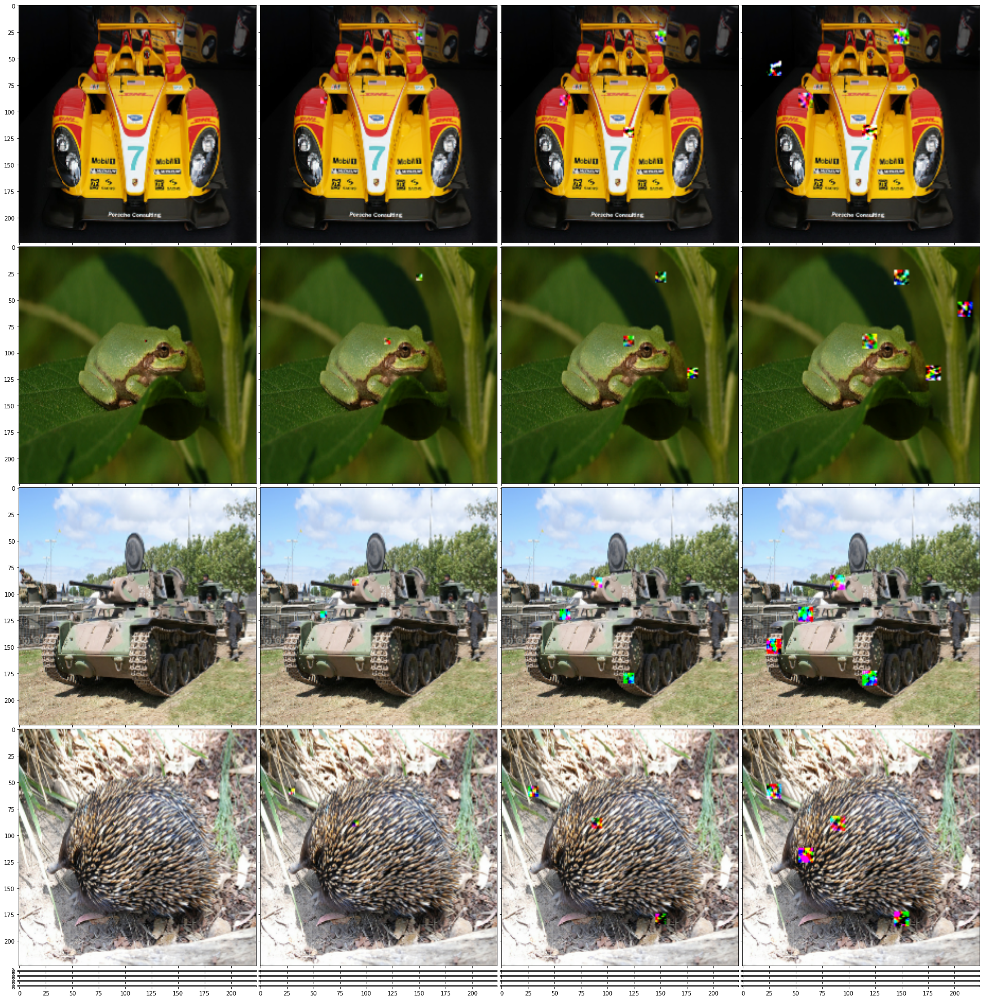

In [ ]:
#Racer
im1_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Pet_images/Car_DARS_2_1.png")
im1 = tf.image.decode_image(im1_raw)
im1 = preprocess(im1)

im2_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Pet_images/Car_DARS_6_2.png")
im2 = tf.image.decode_image(im2_raw)
im2 = preprocess(im2)

im3_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Pet_images/Car_DARS_10_3.png")
im3 = tf.image.decode_image(im3_raw)
im3 = preprocess(im3)

im4_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Pet_images/Car_DARS_14_4.png")
im4 = tf.image.decode_image(im4_raw)
im4 = preprocess(im4)

#Guitar
#im5_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Pet_images/Guitar_DARS_2_1.png")
#im5 = tf.image.decode_image(im5_raw)
#im5 = preprocess(im5)

#im6_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Pet_images/Guitar_DARS_6_2.png")
#im6 = tf.image.decode_image(im6_raw)
#im6 = preprocess(im6)

#im7_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Pet_images/Guitar_DARS_10_3.png")
#im7 = tf.image.decode_image(im7_raw)
#im7 = preprocess(im7)

#im8_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Pet_images/Guitar_DARS_14_4.png")
#im8 = tf.image.decode_image(im8_raw)
#im8 = preprocess(im8)
#Missing Guitar 14-4

#Frog
im9_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Pet_images/Frog_DARS_2_1.png")
im9 = tf.image.decode_image(im9_raw)
im9 = preprocess(im9)

im10_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Pet_images/Frog_DARS_6_2.png")
im10 = tf.image.decode_image(im10_raw)
im10 = preprocess(im10)

im11_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Pet_images/Frog_DARS_10_3.png")
im11 = tf.image.decode_image(im11_raw)
im11 = preprocess(im11)

im12_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Pet_images/Frog_DARS_14_4.png")
im12 = tf.image.decode_image(im12_raw)
im12 = preprocess(im12)

#Beer
#im13_raw = tf.io.read_file(f"//content/gdrive/MyDrive/Data/DAR_data/Pet_images/Beer_DARS_2_1.png")
#im13 = tf.image.decode_image(im13_raw)
#im13 = preprocess(im13)

#im14_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Pet_images/Beer_DARS_6_2.png")
#im14 = tf.image.decode_image(im14_raw)
#im14 = preprocess(im14)

#im15_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Pet_images/Beer_DARS_10_3.png")
#im15 = tf.image.decode_image(im15_raw)
#im15 = preprocess(im15)

#im16_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Pet_images/Beer_DARS_14_4.png")
#im16 = tf.image.decode_image(im16_raw)
#im16 = preprocess(im16)

#Tank
im17_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Pet_images/Tank_DARS_2_1.png")
im17 = tf.image.decode_image(im17_raw)
im17 = preprocess(im17)

im18_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Pet_images/Tank_DARS_6_2.png")
im18 = tf.image.decode_image(im18_raw)
im18 = preprocess(im18)

im19_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Pet_images/Tank_DARS_10_3.png")
im19 = tf.image.decode_image(im19_raw)
im19 = preprocess(im19)

im20_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Pet_images/Tank_DARS_14_4.png")
im20 = tf.image.decode_image(im20_raw)
im20 = preprocess(im20)

#Ship
#im21_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Pet_images/Ship_DARS_2_1.png")
#im21 = tf.image.decode_image(im21_raw)
#im21 = preprocess(im21)

#im22_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Pet_images/Ship_DARS_6_2.png")
#im22 = tf.image.decode_image(im22_raw)
#im22 = preprocess(im22)

#im23_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Pet_images/Ship_DARS_10_3.png")
#im23 = tf.image.decode_image(im23_raw)
#im23 = preprocess(im23)


#im24_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Pet_images/Ship_DARS_14_4.png")
#im24 = tf.image.decode_image(im24_raw)
#im24 = preprocess(im24)

#Bagel
#im25_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Pet_images/Bagel_DARS_2_1.png")
#im25 = tf.image.decode_image(im25_raw)
#im25 = preprocess(im25)

#im26_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Pet_images/Bagel_DARS_6_2.png")
#im26 = tf.image.decode_image(im26_raw)
#im26 = preprocess(im26)

#im27_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Pet_images/Bagel_DARS_10_3.png")
#im27 = tf.image.decode_image(im27_raw)
#im27 = preprocess(im27)


#im28_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Pet_images/Bagel_DARS_14_4.png")
#im28 = tf.image.decode_image(im28_raw)
#im28 = preprocess(im28)

#Echidna
im29_raw = tf.io.read_file(f"//content/gdrive/MyDrive/Data/DAR_data/Pet_images/Echidna_DARS_2_1.png")
im29 = tf.image.decode_image(im29_raw)
im29 = preprocess(im29)

im30_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Pet_images/Echidna_DARS_6_2.png")
im30 = tf.image.decode_image(im30_raw)
im30 = preprocess(im30)

im31_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Pet_images/Echidna_DARS_10_3.png")
im31 = tf.image.decode_image(im31_raw)
im31 = preprocess(im31)

im32_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Pet_images/Echidna_DARS_14_4.png")
im32 = tf.image.decode_image(im32_raw)
im32 = preprocess(im32)


fig = plt.figure(figsize=(32., 32.))
grid = ImageGrid(fig, 111,  # similar to subplot(111)
                 nrows_ncols=(8, 4),  # creates 2x2 grid of axes
                 axes_pad=0.1,  # pad between axes in inch.
                 )

for ax, im in zip(grid, [im1, im2, im3, im4, #im5, im6, im7, im8, 
                         im9, im10, im11, im12, #im13, im14, im15, im16, 
                         im17, im18, im19, im20, #im21, im22, im23, im24, im25, im26, im27, im28, 
                         im29, im30, im31, im32]):
    # Iterating over the grid returns the Axes.
    ax.imshow(im[0] * 0.5 + 0.5)  # To change [-1, 1] to [0,1]

plt.savefig("/content/gdrive/MyDrive/Data/DAR_data/Results/imagenetpetimages.png")
plt.show()

Display perturbed images from COIL

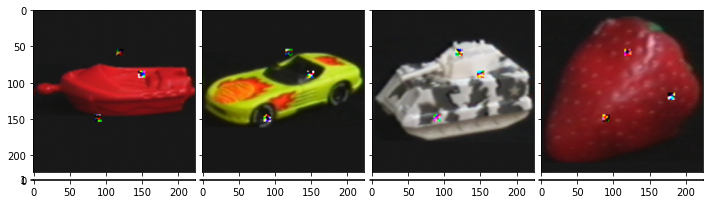

In [ ]:
im1_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Pet_images/COIL_DARS_10_3_5.png")
im1 = tf.image.decode_image(im1_raw)
im1 = preprocess(im1)


#im2_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Pet_images/Pet_Cup_DARS_3.png")
#im2 = tf.image.decode_image(im2_raw)
#im2 = preprocess(im2)

im3_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Pet_images/COIL_DARS_10_3_3.png")
im3 = tf.image.decode_image(im3_raw)
im3 = preprocess(im3)

#im4_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Pet_images/Pet_Plate_DARS_3.png")
#im4 = tf.image.decode_image(im4_raw)
#im4 = preprocess(im4)

im5_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Pet_images/COIL_DARS_10_3_6.png")
im5 = tf.image.decode_image(im5_raw)
im5 = preprocess(im5)

im6_raw = tf.io.read_file(f"//content/gdrive/MyDrive/Data/DAR_data/Pet_images/COIL_DARS_10_3_1.png")
im6 = tf.image.decode_image(im6_raw)
im6 = preprocess(im6)

#im7_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Pet_images/Pet_Sandwich_DARS_3.png")
#im7 = tf.image.decode_image(im7_raw)
#im7 = preprocess(im7)

#im8_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Pet_images/Pet_Duck_DARS_3.png")
#im8 = tf.image.decode_image(im8_raw)
#im8 = preprocess(im8)


fig = plt.figure(figsize=(12., 12.))
grid = ImageGrid(fig, 111,  # similar to subplot(111)
                 nrows_ncols=(2, 4),  # creates 2x2 grid of axes
                 axes_pad=0.1,  # pad between axes in inch.
                 )

for ax, im in zip(grid, [im1, im3, im5, im6]):
    # Iterating over the grid returns the Axes.
    ax.imshow(im[0] * 0.5 + 0.5)  # To change [-1, 1] to [0,1]

plt.savefig("/content/gdrive/MyDrive/Data/DAR_data/Results/coilpetimages.png")
plt.show()

Display clean images - original

In [ ]:
im1_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Object_1/obj6__10.png")
im1 = tf.image.decode_image(im1_raw)
im1 = preprocess(im1)

im2_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Object_2/obj10__0.png")
im2 = tf.image.decode_image(im2_raw)
im2 = preprocess(im2)

im3_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Object_3/obj28__0.png")
im3 = tf.image.decode_image(im3_raw)
im3 = preprocess(im3)


im4_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Object_4/obj35__0.png")
im4 = tf.image.decode_image(im4_raw)
im4 = preprocess(im4)

im5_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Object_5/obj37__35.png")
im5 = tf.image.decode_image(im5_raw)
im5 = preprocess(im5)

im6_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Object_6/obj38__0.png")
im6 = tf.image.decode_image(im6_raw)
im6 = preprocess(im6)

im7_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Object_7/obj53__0.png")
im7 = tf.image.decode_image(im7_raw)
im7 = preprocess(im7)

im8_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Object_8/obj74__130.png")
im8 = tf.image.decode_image(im8_raw)
im8 = preprocess(im8)


fig = plt.figure(figsize=(12., 12.))
grid = ImageGrid(fig, 111,  # similar to subplot(111)
                 nrows_ncols=(2, 4),  # creates 2x2 grid of axes
                 axes_pad=0.1,  # pad between axes in inch.
                 )

for ax, im in zip(grid, [im1, im2, im3, im4, im5, im6, im7, im8]):
    # Iterating over the grid returns the Axes.
    ax.imshow(im[0] * 0.5 + 0.5)  # To change [-1, 1] to [0,1]

plt.savefig("/content/gdrive/MyDrive/Data/DAR_data/cleanimages.png")
plt.show()

# Faces

1/1 [==============================] - 0s 17ms/step
120
0


/usr/local/lib/python3.8/dist-packages/pandas/core/indexing.py:1817: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_column(loc, value, pi)


Only calculates 1-4 DARS


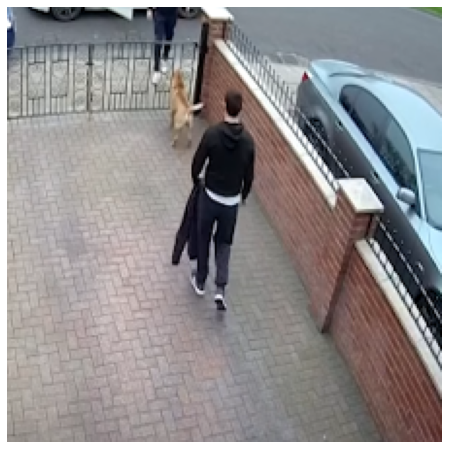

1/1 [==============================] - 0s 32ms/step
[[('n03141823', 'crutch', 0.10869689), ('n03670208', 'limousine', 0.07663921), ('n02917067', 'bullet_train', 0.048879072), ('n02788148', 'bannister', 0.04369497), ('n04005630', 'prison', 0.034881663)]]
1/1 [==============================] - 4s 4s/step
[[('n02917067', 'bullet_train', 0.44924095), ('n03899768', 'patio', 0.14278957), ('n03452741', 'grand_piano', 0.018257458), ('n04239074', 'sliding_door', 0.018192792), ('n04515003', 'upright', 0.011327619)]]
1/1 [==============================] - 3s 3s/step
[[('n03160309', 'dam', 0.44374806), ('n02096585', 'Boston_bull', 0.1836474), ('n02917067', 'bullet_train', 0.042759873), ('n02860847', 'bobsled', 0.042606983), ('n02667093', 'abaya', 0.035150945)]]


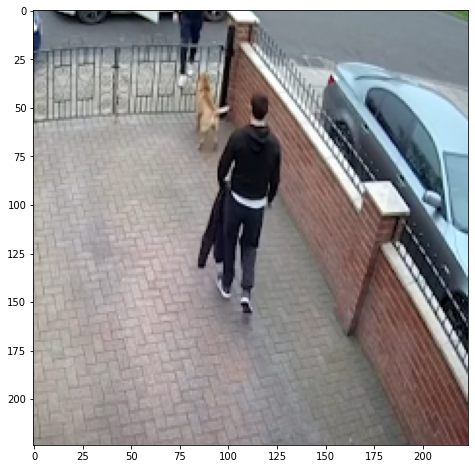

1/1 [==============================] - 0s 27ms/step
[[('n03141823', 'crutch', 0.10869689), ('n03670208', 'limousine', 0.07663921), ('n02917067', 'bullet_train', 0.048879072), ('n02788148', 'bannister', 0.04369497), ('n04005630', 'prison', 0.034881663)]]
1/1 [==============================] - 0s 32ms/step
[[('n02917067', 'bullet_train', 0.44924095), ('n03899768', 'patio', 0.14278957), ('n03452741', 'grand_piano', 0.018257458), ('n04239074', 'sliding_door', 0.018192792), ('n04515003', 'upright', 0.011327619)]]
1/1 [==============================] - 0s 29ms/step
[[('n03160309', 'dam', 0.44374806), ('n02096585', 'Boston_bull', 0.1836474), ('n02917067', 'bullet_train', 0.042759873), ('n02860847', 'bobsled', 0.042606983), ('n02667093', 'abaya', 0.035150945)]]
1/1 [==============================] - 0s 28ms/step
crutch
1/1 [==============================] - 0s 22ms/step
0.10869689
1/1 [==============================] - 0s 17ms/step
limousine
1/1 [==============================] - 0s 23ms/step


Only calculates 1-4 DARS


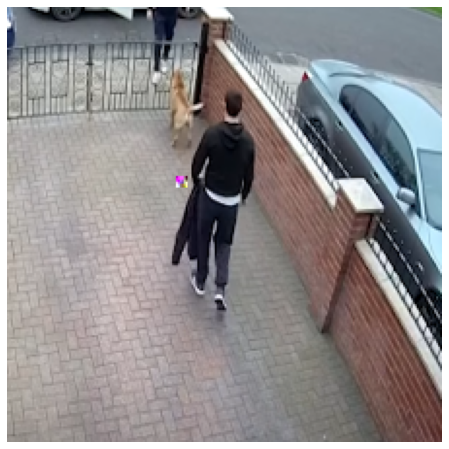

1/1 [==============================] - 0s 32ms/step
[[('n03670208', 'limousine', 0.11860841), ('n03141823', 'crutch', 0.09655102), ('n02917067', 'bullet_train', 0.08146144), ('n02788148', 'bannister', 0.06311286), ('n04336792', 'stretcher', 0.03361445)]]
1/1 [==============================] - 0s 41ms/step
[[('n02917067', 'bullet_train', 0.7486284), ('n03899768', 'patio', 0.029369878), ('n02860847', 'bobsled', 0.017710159), ('n04239074', 'sliding_door', 0.0069465246), ('n03670208', 'limousine', 0.0061979867)]]
1/1 [==============================] - 0s 33ms/step
[[('n03160309', 'dam', 0.34814242), ('n02667093', 'abaya', 0.1396896), ('n02917067', 'bullet_train', 0.11804432), ('n02860847', 'bobsled', 0.048230723), ('n02096585', 'Boston_bull', 0.039763946)]]


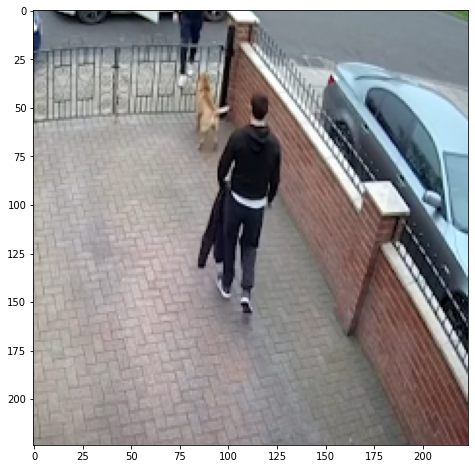

1/1 [==============================] - 0s 38ms/step
[[('n03141823', 'crutch', 0.10869689), ('n03670208', 'limousine', 0.07663921), ('n02917067', 'bullet_train', 0.048879072), ('n02788148', 'bannister', 0.04369497), ('n04005630', 'prison', 0.034881663)]]
1/1 [==============================] - 0s 35ms/step
[[('n02917067', 'bullet_train', 0.44924095), ('n03899768', 'patio', 0.14278957), ('n03452741', 'grand_piano', 0.018257458), ('n04239074', 'sliding_door', 0.018192792), ('n04515003', 'upright', 0.011327619)]]
1/1 [==============================] - 0s 31ms/step
[[('n03160309', 'dam', 0.44374806), ('n02096585', 'Boston_bull', 0.1836474), ('n02917067', 'bullet_train', 0.042759873), ('n02860847', 'bobsled', 0.042606983), ('n02667093', 'abaya', 0.035150945)]]
1/1 [==============================] - 0s 25ms/step
limousine
1/1 [==============================] - 0s 21ms/step
0.11860841
1/1 [==============================] - 0s 26ms/step
crutch
1/1 [==============================] - 0s 20ms/step


Only calculates 1-4 DARS


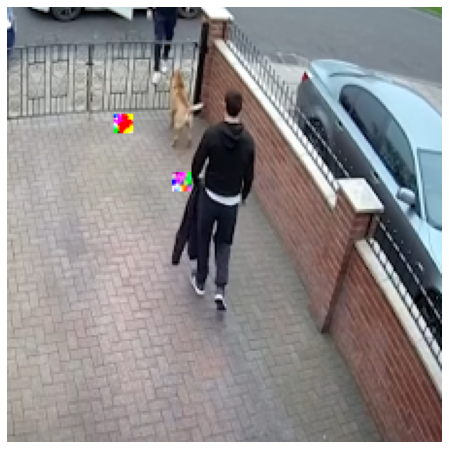

1/1 [==============================] - 0s 26ms/step
[[('n03670208', 'limousine', 0.12343667), ('n02788148', 'bannister', 0.09833541), ('n02917067', 'bullet_train', 0.08705441), ('n03141823', 'crutch', 0.053287532), ('n04336792', 'stretcher', 0.036559932)]]
1/1 [==============================] - 0s 51ms/step
[[('n02917067', 'bullet_train', 0.79974127), ('n06874185', 'traffic_light', 0.043603636), ('n03942813', 'ping-pong_ball', 0.014230522), ('n03602883', 'joystick', 0.009046233), ('n03670208', 'limousine', 0.0053727455)]]
1/1 [==============================] - 0s 30ms/step
[[('n03160309', 'dam', 0.44901693), ('n02917067', 'bullet_train', 0.08995493), ('n02667093', 'abaya', 0.044699155), ('n02096585', 'Boston_bull', 0.038266774), ('n02860847', 'bobsled', 0.023098424)]]


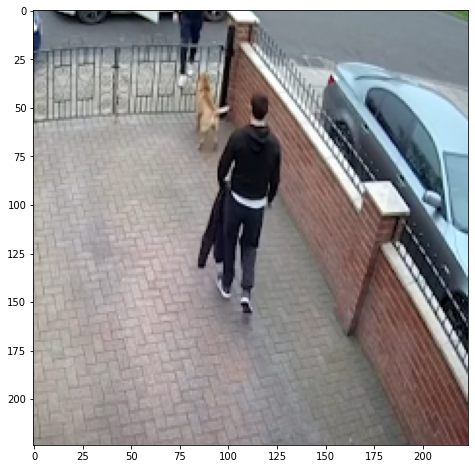

1/1 [==============================] - 0s 27ms/step
[[('n03141823', 'crutch', 0.10869689), ('n03670208', 'limousine', 0.07663921), ('n02917067', 'bullet_train', 0.048879072), ('n02788148', 'bannister', 0.04369497), ('n04005630', 'prison', 0.034881663)]]
1/1 [==============================] - 0s 36ms/step
[[('n02917067', 'bullet_train', 0.44924095), ('n03899768', 'patio', 0.14278957), ('n03452741', 'grand_piano', 0.018257458), ('n04239074', 'sliding_door', 0.018192792), ('n04515003', 'upright', 0.011327619)]]
1/1 [==============================] - 0s 30ms/step
[[('n03160309', 'dam', 0.44374806), ('n02096585', 'Boston_bull', 0.1836474), ('n02917067', 'bullet_train', 0.042759873), ('n02860847', 'bobsled', 0.042606983), ('n02667093', 'abaya', 0.035150945)]]
1/1 [==============================] - 0s 18ms/step
limousine
1/1 [==============================] - 0s 25ms/step
0.12343667
1/1 [==============================] - 0s 29ms/step
bannister
1/1 [==============================] - 0s 26ms/st

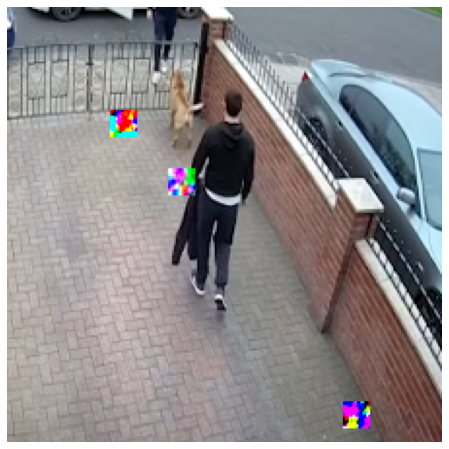

1/1 [==============================] - 0s 26ms/step
[[('n02788148', 'bannister', 0.12736063), ('n04039381', 'racket', 0.107100606), ('n02917067', 'bullet_train', 0.07968649), ('n04228054', 'ski', 0.07129792), ('n03670208', 'limousine', 0.036368027)]]
1/1 [==============================] - 0s 47ms/step
[[('n06874185', 'traffic_light', 0.81973714), ('n04286575', 'spotlight', 0.056300443), ('n04009552', 'projector', 0.020631688), ('n03602883', 'joystick', 0.0065122605), ('n03670208', 'limousine', 0.005505838)]]
1/1 [==============================] - 0s 39ms/step
[[('n03160309', 'dam', 0.42692104), ('n02917067', 'bullet_train', 0.18645109), ('n02687172', 'aircraft_carrier', 0.023895845), ('n04347754', 'submarine', 0.022473942), ('n03670208', 'limousine', 0.017104166)]]


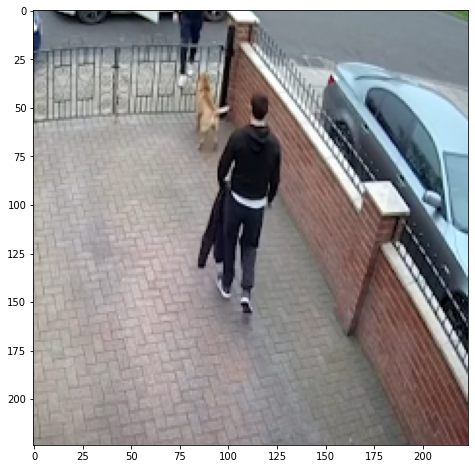

1/1 [==============================] - 0s 29ms/step
[[('n03141823', 'crutch', 0.10869689), ('n03670208', 'limousine', 0.07663921), ('n02917067', 'bullet_train', 0.048879072), ('n02788148', 'bannister', 0.04369497), ('n04005630', 'prison', 0.034881663)]]
1/1 [==============================] - 0s 47ms/step
[[('n02917067', 'bullet_train', 0.44924095), ('n03899768', 'patio', 0.14278957), ('n03452741', 'grand_piano', 0.018257458), ('n04239074', 'sliding_door', 0.018192792), ('n04515003', 'upright', 0.011327619)]]
1/1 [==============================] - 0s 51ms/step
[[('n03160309', 'dam', 0.44374806), ('n02096585', 'Boston_bull', 0.1836474), ('n02917067', 'bullet_train', 0.042759873), ('n02860847', 'bobsled', 0.042606983), ('n02667093', 'abaya', 0.035150945)]]
1/1 [==============================] - 0s 20ms/step
bannister
1/1 [==============================] - 0s 34ms/step
0.12736063
1/1 [==============================] - 0s 30ms/step
racket
1/1 [==============================] - 0s 27ms/step


In [ ]:
size = [2,6,10,14] #Need to check it goes through every combination of size and number. Also check that number = 1,2,3,4 (it's only 2 or 3)

number = 1
for i,size in enumerate(size):
  #All this stuff gets changed for each image
  Obj = 'Face'
  real_label_index = 751 #Racer
  #Obj = 'Car_COIL'
  #Obj = 'Car'
  #real_label_index = 31 #Frog
  #Obj = 'Frog'
  #real_label_index = 402 #Guitar
  #Obj = 'Guitar'
  #real_label_index = 440 #Beer
  #Obj = 'Beer'
  #real_label_index = 847 #Tank
  #Obj = 'Tank'
  #real_label_index = 510 #Container Ship
  #Obj = 'Ship'
  #real_label_index = 931 #Bagel
  #Obj = 'Bagel'
  #real_label_index = 102 #Echidna
  #Obj = 'Echidna'

  #Note - I've since delted the One folders

  #Face
  im1_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Faces/106.png")
  #Racer ImageNet
  #im1_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Imagenet_racer/n04037443_10675.JPEG")
  #Racer COIL
  #im1_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Object_1/obj6__10.png")
  #Guitar
  #im1_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Imagenet_guitar/One/Copy of n02676566_10902.JPEG")
  #Frog
  #im1_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Imagenet_frog/imagenet_frog.JPEG")
  #Beer
  #im1_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Imagenet_beer/imagenet_beer.JPEG")
  #Tank
  #im1_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Imagenet_tank/One/Copy of imagenet_tank.JPEG")
  #Ship
  #im1_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Imagenet_ship/n03095699_10641.JPEG")
  #Bagel
  #im1_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Imagenet_bagel/One/Copy of n07693725_10068.JPEG")
  #Echidna
  #im1_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Imagenet_echidna/One/Copy of n01872401_1032.JPEG")

  model = mobilenetv2
  x_value = []
  y_value = []
  size_val = []
  num_val = []
  conf_results = []
  imgclassmobilenetpet = []
  predsmobilenetpet = []
  imgclassmobilenetpet_top2 = []
  predsmobilenetpet_top2 = []
  imgclassmobilenetpet_top3 = []
  predsmobilenetpet_top3 = []
  imgclassnasnetpet = []
  predsnasnetpet = []
  imgclassnasnetpet_top2 = []
  predsnasnetpet_top2 = []
  imgclassnasnetpet_top3 = []
  predsnasnetpet_top3 = []
  imgclassdensenetpet = []
  predsdensenetpet = []  
  imgclassdensenetpet_top2 = []
  predsdensenetpet_top2 = []
  imgclassdensenetpet_top3 = []
  predsdensenetpet_top3 = []
  imgclassmobilenet = []
  predsmobilenet = []
  imgclassmobilenet_top2 = []
  predsmobilenet_top2 = []
  imgclassmobilenet_top3 = []
  predsmobilenet_top3 = []
  imgclassnasnet = []
  predsnasnet = []
  imgclassnasnet_top2 = []
  predsnasnet_top2 = []
  imgclassnasnet_top3 = []
  predsnasnet_top3 = []
  imgclassdensenet = []
  predsdensenet = []
  imgclassdensenet_top2 = []
  predsdensenet_top2 = []
  imgclassdensenet_top3 = []
  predsdensenet_top3 = []

# Figure out why locations aren't updating for some pictures, and why other models have same result
    #im1_raw = tf.io.read_file(f"/content/gdrive/MyDrive/Data/DAR_data/Imagenet_racer/{file}")
  im1 = tf.image.decode_image(im1_raw)
  image = preprocess(im1)

  adv_dar(image)
  include = [1]*len(x_value)
  create_adv_dars_auto(size,number)

    #Save results
  g = gen_mod_results() #Need to 'clean' results csv
  #g.to_csv('/content/gdrive/MyDrive/Data/DAR_data/Results/cleanresults.csv', mode='a', sep='\t')
  d = gen_mod_results_pet()
  #d.to_csv('/content/gdrive/MyDrive/Data/DAR_data/Results/petresults.csv', mode='a', sep='\t')
  
  if number <4:
    number = number+1
  else:
    number = 1